In [1]:
import numpy as np
from scipy.misc import imresize
import pylab
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from skimage import transform, filters
import sys, pylab, operator, csv
#import util
import os
import urllib

%matplotlib notebook

%load_ext autoreload
%autoreload 2

import caffe

from helpers import *
from heatmaps import *
from repro_EB_figs import *
from optimize_mask import *

In [2]:
gpu = 0
net_type = 'googlenet'

caffe.set_device(gpu)
caffe.set_mode_gpu()

net = get_net(net_type)

In [3]:
labels_desc = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synset_words.txt', str, delimiter='\t')
synsets = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synsets.txt', str, delimiter='\t')
(paths, labels) = read_imdb('/home/ruthfong/packages/caffe/data/ilsvrc12/annotated_train_heldout_imdb.txt')
data_desc = 'train_heldout'
paths = np.array(paths)
labels = np.array(labels)
ann_dir = '/data/ruthfong/ILSVRC2012/annotated_train_heldout_ground_truth_annotations'
ann_paths = np.sort([os.path.join(ann_dir, f) for f in os.listdir(ann_dir)])
res_dir = '/data/ruthfong/neural_coding/pycaffe_results'
mask_rel_dir = 'googlenet_train_heldout_given_grad_1_norm_0/min_top0_prob_blur/lr_-1.00_l1_lambda_-4.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_3.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
#mask_rel_dir = 'googlenet_train_heldout_given_grad_1_norm_0/min_top5_prob_blur/lr_-1.00_l1_lambda_-3.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_2.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
mask_paths = [os.path.join(res_dir, mask_rel_dir, '%d.npy' % x) for x in range(len(labels))]
fig_dir = '/home/ruthfong/neural_coding/paper_figures'

In [4]:
# target score mask
#mask_dir = '/data/ruthfong/neural_coding/pycaffe_results/googlenet_train_heldout_given_grad_1_norm_0/min_top0_prob_blur/lr_-1.00_l1_lambda_-4.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_3.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
#mask_paths = [os.path.join(mask_dir, '%d.npy' % i) for i in range(5000)]
mask_alpha = 1.0

In [86]:
objs = load_objs(ann_paths[12])
print objs

{'n07836838': [[102, 14, 373, 244]]}


In [87]:
def disp_img(img_path, resize = None, mask_path = None, hide_ticks = True, title = None, fig_path = None):
    f, ax = plt.subplots(1,1)
    img = caffe.io.load_image(img_path)
    if resize is not None:
        img = scipy.misc.imresize(img, resize)
    if mask_path is not None:
        mask = np.load(mask_path)
        if resize is not None and mask.shape != resize:
            mask = scipy.misc.imresize(mask, resize)
        else:
            mask = imresize(mask, img.shape[:2])
        ax.imshow(img)
        #cmap = plt.get_cmap('jet')
        #mask = cmap(mask)
        #mask = np.delete(mask, 3, 2)
        ax.imshow(mask, alpha = 0.5, cmap = 'jet')
        #img = 0.5*img + 0.5*mask
    else:
        ax.imshow(img)
    if hide_ticks:
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    if title is not None:
        ax.set_title(title)
    #plt.tight_layout()
    f.subplots_adjust(wspace=0,hspace=0)
    if fig_path != None:
        plt.savefig(fig_path, bb_inches='tight', pad_inches=0.0)

In [88]:
def resized_bbs(bbs, curr_size, new_size):
    [x0, y0, x1, y1] = bbs
    mask = np.zeros(curr_size)
    mask[y0:y1,x0:x1] = 1
    new_mask = imresize(mask, new_size)/float(255)
    x = np.where(new_mask.sum(0) > 0.5)[0]+1
    y = np.where(new_mask.sum(1) > 0.5)[0]+1
    return [x[0],y[0],x[-1],y[-1]]

In [89]:
def mask_img(net, img_path, label, bb_coords, fig_path = None, labels_desc = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synset_words.txt', str, delimiter='\t')):
    net_transformer = get_ILSVRC_net_transformer(net)
    orig_img = caffe.io.load_image(img_path)
    img = net_transformer.preprocess('data', orig_img)
    null_img = net_transformer.preprocess('data', get_blurred_img(img_path))
    #bb_mask = np.ones(caffe.io.load_image(img_path).shape[:2])
    bb_mask = np.ones(img.shape[1:])
    [x0, y0, x1, y1] = bb_coords
    bb_mask[y0:y1, x0:x1] = 0
    #bb_mask = scipy.misc.imresize(bb_mask, (net.blobs['data'].data.shape[2], 
    #                                        net.blobs['data'].data.shape[3]), 'nearest')/float(255)
    
    bb_masked_img = img * bb_mask + null_img * (1 - bb_mask)

    net.blobs['data'].data[...] = bb_masked_img
    net.forward()
    scores = np.squeeze(net.blobs['prob'].data)
    sorted_idx = np.argsort(scores)

    for i in range(5):
        print (i+1), labels_desc[sorted_idx[-(i+1)]], scores[sorted_idx[-(i+1)]]

    f, ax = plt.subplots(1,1)
    ax.imshow(imresize(net_transformer.deprocess('data', bb_masked_img), orig_img.shape[:2]))
    [x0, y0, x1, y1] = resized_bbs(bb_coords, bb_mask.shape, orig_img.shape[:2])
    ax.add_patch(
        patches.Rectangle(
            (x0, y0),
            x1-x0,
            y1-y0,
            linewidth=1,
            edgecolor='r',
            facecolor='none'
        )
    )
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_title('%s: %.3f' % (get_short_class_name(label), scores[label]))
    #ax.set_title('%s: %.3f (%s: %.3f)' % (get_short_class_name(sorted_idx[-1]), scores[sorted_idx[-1]], get_short_class_name(label), scores[label]))
    #plt.tight_layout()
    f.subplots_adjust(wspace=0,hspace=0)
    if fig_path != None:
        plt.savefig(fig_path, bb_inches='tight', pad_inches=0.0)

In [130]:
def manual_edit_img(net, img_path, label, mask_path, objs_bbs, fig_path = None):
    num_bbs = len(objs_bbs)
    f, ax = plt.subplots(1, num_bbs+1)
    img = caffe.io.load_image(img_path)
    mask = np.load(mask_path)
    mask = imresize(mask, img.shape[:2])

    net_transformer = get_ILSVRC_net_transformer(net)
    img_ = net_transformer.preprocess('data', img)
    null_img_ = net_transformer.preprocess('data', get_blurred_img(img_path))
    
    scores = np.squeeze(forward_pass(net, img_))
    orig_score = scores[label]
    print labels_desc[label], scores[label]
    ax[0].imshow(img)
    ax[0].imshow(mask, alpha = 0.5, cmap = 'jet')
    ax[0].set_title('Mask Overlay')
    ax[0].set_ylabel(get_short_class_name(label))

    for i in range(num_bbs):
        bb_mask = np.ones(img_.shape[1:])
        [x0, y0, x1, y1] = objs_bbs[i]
        bb_mask[y0:y1, x0:x1] = 0
        bb_masked_img = img_ * bb_mask + null_img_ * (1 - bb_mask)
        scores = np.squeeze(forward_pass(net, bb_masked_img))
        sorted_idx = np.argsort(scores)

        for j in range(5):
            print (j+1), labels_desc[sorted_idx[-(j+1)]], scores[sorted_idx[-(j+1)]]

        ax[i+1].imshow(imresize(net_transformer.deprocess('data', bb_masked_img), img.shape[:2]))
        [x0, y0, x1, y1] = resized_bbs(objs_bbs[i], bb_mask.shape, img.shape[:2])
        ax[i+1].add_patch(
            patches.Rectangle(
                (x0, y0),
                x1-x0,
                y1-y0,
                linewidth=1,
                edgecolor='r',
                facecolor='none'
            )
        )
        ax[i+1].set_title('%.3f => %.3f' % (orig_score, scores[label]))

    for a in ax:
        a.get_xaxis().set_ticks([])
        a.get_yaxis().set_ticks([])
    
    plt.tight_layout()
    #f.subplots_adjust(wspace=0.05,hspace=0)
    if fig_path != None:
        plt.savefig(fig_path, bb_inches='tight', pad_inches=0.0)

960


<IPython.core.display.Javascript object>


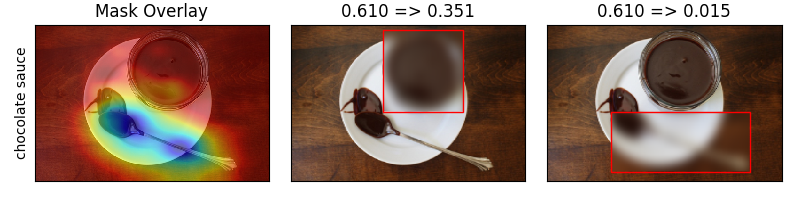

n07836838 chocolate sauce, chocolate syrup 0.60982
1 n07836838 chocolate sauce, chocolate syrup 0.350537
2 n03633091 ladle 0.278316
3 n04277352 spindle 0.213342
4 n04597913 wooden spoon 0.0293983
5 n04356056 sunglasses, dark glasses, shades 0.0238978
1 n04398044 teapot 0.534978
2 n04131690 saltshaker, salt shaker 0.132993
3 n03063689 coffeepot 0.0694593
4 n07930864 cup 0.0458275
5 n04332243 strainer 0.0248605


In [131]:
#%matplotlib notebook
# chocolate sauce
ind = 12
img_path = paths[ind]
label = labels[ind]
print label
mask_path = mask_paths[ind]
ann_path = ann_paths[ind]

obj1_bb = [88, 7, 164, 124] # pot
obj2_bb = [61, 125, 193, 210] # spoon

objs_bbs = [obj1_bb, obj2_bb]
pylab.rcParams['figure.figsize'] = (8, 2.0)
manual_edit_img(net, img_path, label, mask_path, objs_bbs, fig_path = os.path.join(fig_dir, 'chocolate_masked_example.pdf'))

#disp_img(img_path, (224,224))

#disp_img(img_path, mask_path = mask_path, title = 'Mask Overlay', fig_path = os.path.join(fig_dir, 'chocolate_img_mask.pdf'))

#obj1_bb = [205, 25,375, 180] # coordinates on original image before resizing
#mask_img(net, img_path, label, obj1_bb, fig_path = os.path.join(fig_dir, 'chocolate_masked_pot.pdf'))

#mask_img(net, img_path, label, obj2_bb, fig_path = os.path.join(fig_dir, 'chocolate_masked_spoon.pdf'))

<IPython.core.display.Javascript object>


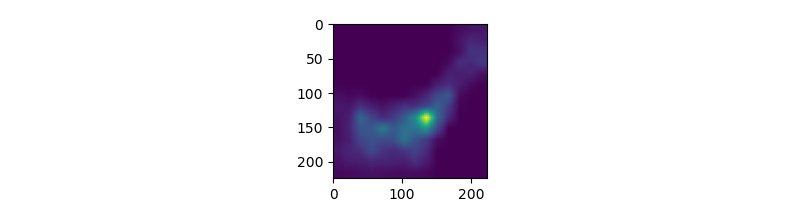

<IPython.core.display.Javascript object>


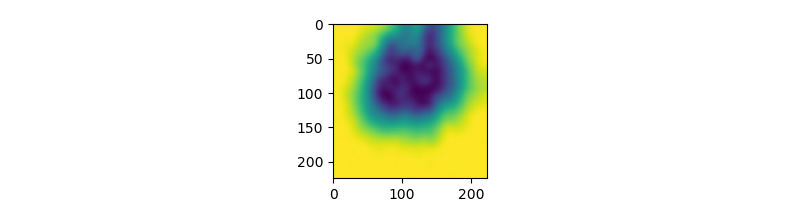

<IPython.core.display.Javascript object>


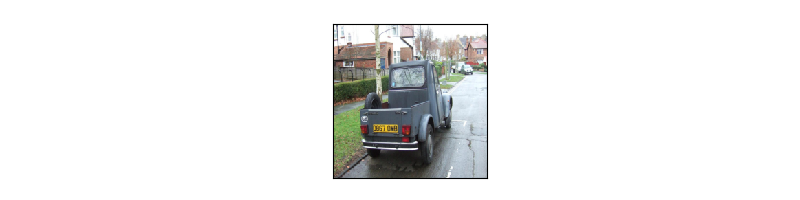

<IPython.core.display.Javascript object>


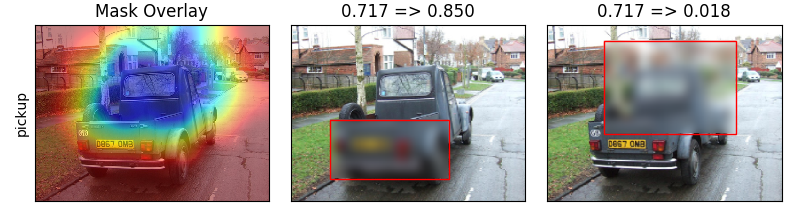

n03930630 pickup, pickup truck 0.716902
1 n03930630 pickup, pickup truck 0.849733
2 n04461696 tow truck, tow car, wrecker 0.108993
3 n04252225 snowplow, snowplough 0.0120875
4 n03777568 Model T 0.00924043
5 n03594945 jeep, landrover 0.00910707
1 n03445924 golfcart, golf cart 0.238696
2 n03417042 garbage truck, dustcart 0.0989019
3 n04037443 racer, race car, racing car 0.0842011
4 n02930766 cab, hack, taxi, taxicab 0.0694725
5 n04467665 trailer truck, tractor trailer, trucking rig, rig, articulated lorry, semi 0.0688623


In [132]:
#%matplotlib notebook
# pick up truck
ind = 30
img_path = paths[ind]
label = labels[ind]
mask_path = mask_paths[ind]
ann_path = ann_paths[ind]

transformer = get_ILSVRC_net_transformer(net)
heatmap = compute_heatmap(net, transformer, img_path, label, 'contrast_excitation_backprop', 'loss3/classifier', 'loss3/classifier',
                    outputBlobName = 'pool3/3x3_s2', outputLayerName = 'pool3/3x3_s2', secondTopBlobName = 'pool5/7x7_s1',
                    secondTopLayerName = 'pool5/7x7_s1', norm_deg = -2, gpu = gpu)
f, ax = plt.subplots(1,1)
ax.imshow(imresize(heatmap, (224,224)))

mask = np.load(mask_path)
f, ax = plt.subplots(1,1)
ax.imshow(mask)

disp_img(img_path, (224,224))

obj1_bb = [37,120,150,195] # contrast_excitation_backprop
obj2_bb = [54, 20, 180, 138] # mask

objs_bbs = [obj1_bb, obj2_bb]

pylab.rcParams['figure.figsize'] = (8, 2.2)
manual_edit_img(net, img_path, label, mask_path, objs_bbs, fig_path = os.path.join(fig_dir, 'truck_masked_example.pdf'))

#disp_img(img_path, mask_path = mask_path, title = 'Mask Overlay', fig_path = os.path.join(fig_dir, 'chocolate_img_mask.pdf'))

#obj1_bb = [205, 25,375, 180] # coordinates on original image before resizing
#mask_img(net, img_path, label, obj1_bb, fig_path = os.path.join(fig_dir, 'chocolate_masked_pot.pdf'))

#mask_img(net, img_path, label, obj2_bb, fig_path = os.path.join(fig_dir, 'chocolate_masked_spoon.pdf'))

<IPython.core.display.Javascript object>


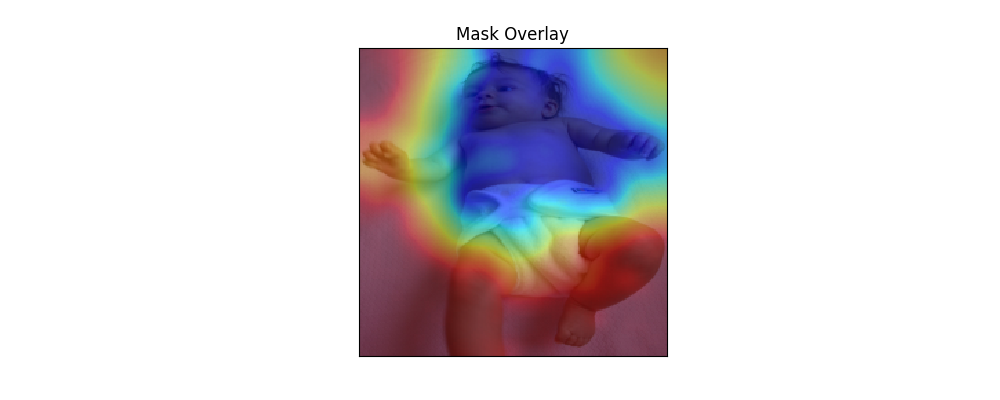

1 n03188531 diaper, nappy, napkin 0.627574
2 n04493381 tub, vat 0.215984
3 n02808440 bathtub, bathing tub, bath, tub 0.0890319
4 n02808304 bath towel 0.0192397
5 n04371430 swimming trunks, bathing trunks 0.0106565


<IPython.core.display.Javascript object>


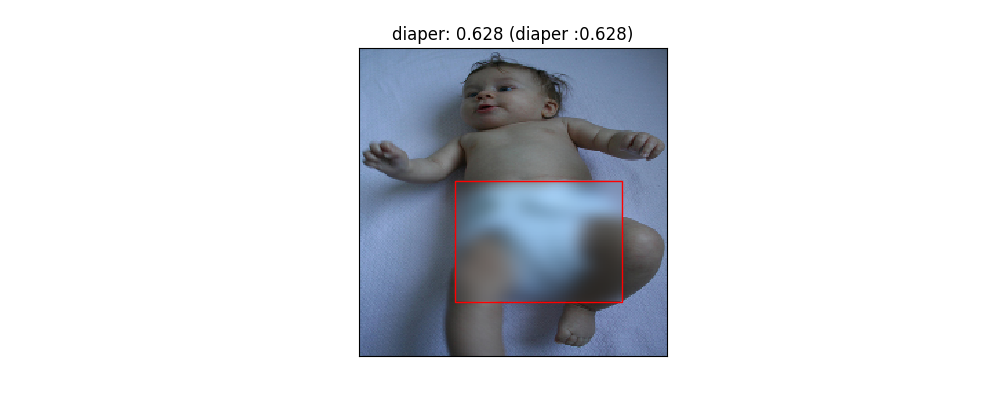

1 n03188531 diaper, nappy, napkin 0.950823
2 n15075141 toilet tissue, toilet paper, bathroom tissue 0.00871057
3 n03825788 nipple 0.00723438
4 n02808304 bath towel 0.00535755
5 n03255030 dumbbell 0.0046719


<IPython.core.display.Javascript object>


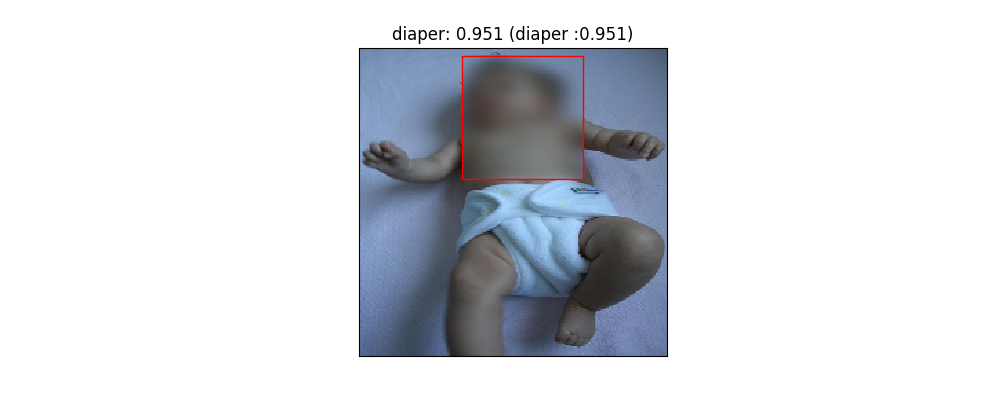

In [56]:
#%matplotlib notebook
# diaper
ind = 311
img_path = paths[ind]
label = labels[ind]
mask_path = mask_paths[ind]
ann_path = ann_paths[ind]

#disp_img(img_path, (224,224))
disp_img(img_path, (224,224), mask_path, title = 'Mask Overlay')

obj_bb = [70, 96, 191, 184] # diaper
mask_img(net, img_path, label, obj_bb)

obj_bb = [75, 5, 163, 95] # upper half of baby
mask_img(net, img_path, label, obj_bb)

<IPython.core.display.Javascript object>


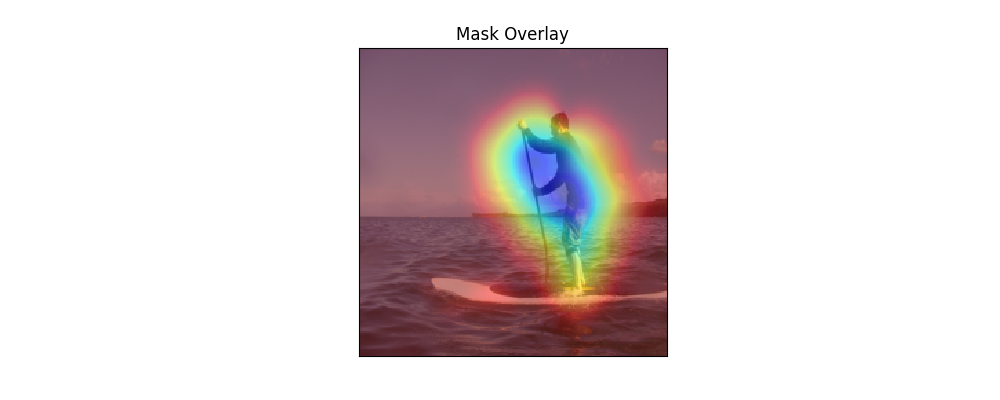

1 n03873416 paddle, boat paddle 0.26808
2 n09421951 sandbar, sand bar 0.16641
3 n09428293 seashore, coast, seacoast, sea-coast 0.0759374
4 n03976657 pole 0.0526312
5 n09332890 lakeside, lakeshore 0.0390223


<IPython.core.display.Javascript object>


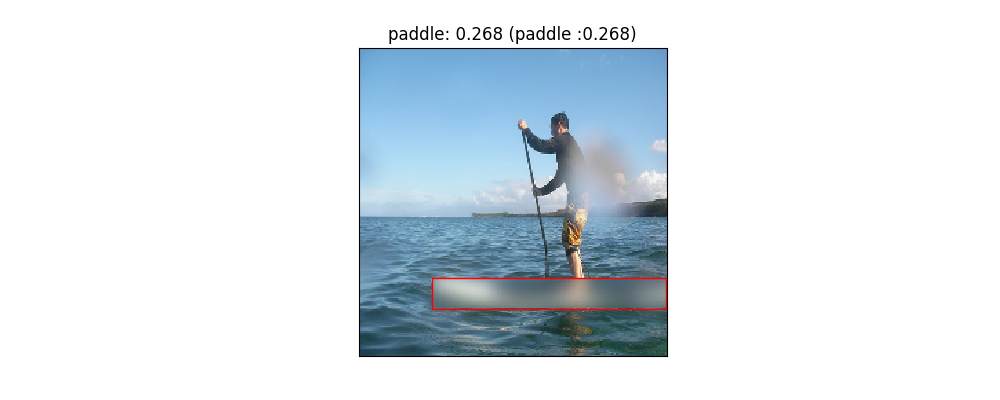

1 n09428293 seashore, coast, seacoast, sea-coast 0.198519
2 n09421951 sandbar, sand bar 0.130719
3 n02071294 killer whale, killer, orca, grampus, sea wolf, Orcinus orca 0.0985705
4 n02066245 grey whale, gray whale, devilfish, Eschrichtius gibbosus, Eschrichtius robustus 0.0854408
5 n02894605 breakwater, groin, groyne, mole, bulwark, seawall, jetty 0.0844952


<IPython.core.display.Javascript object>


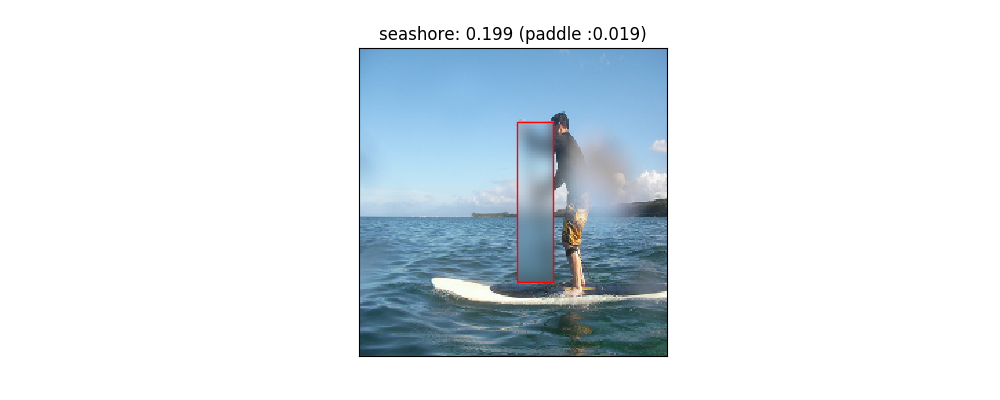

1 n04483307 trimaran 0.150717
2 n02066245 grey whale, gray whale, devilfish, Eschrichtius gibbosus, Eschrichtius robustus 0.108594
3 n04147183 schooner 0.100694
4 n03344393 fireboat 0.0869052
5 n02071294 killer whale, killer, orca, grampus, sea wolf, Orcinus orca 0.0625958


<IPython.core.display.Javascript object>


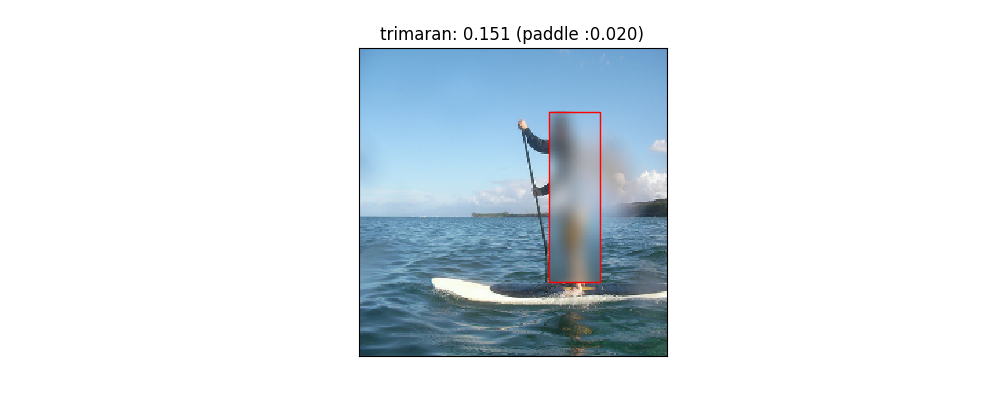

In [58]:
#%matplotlib notebook
# diaper
ind = 301
img_path = paths[ind]
label = labels[ind]
mask_path = mask_paths[ind]
ann_path = ann_paths[ind]

#disp_img(img_path, (224,224))
disp_img(img_path, (224,224), mask_path, title = 'Mask Overlay')

obj_bb = [53, 167, 223, 189] # paddleboard
mask_img(net, img_path, label, obj_bb)

obj_bb = [115, 53, 141, 170] # paddle
mask_img(net, img_path, label, obj_bb)

obj_bb = [138, 46, 175, 170] # person
mask_img(net, img_path, label, obj_bb)

<IPython.core.display.Javascript object>


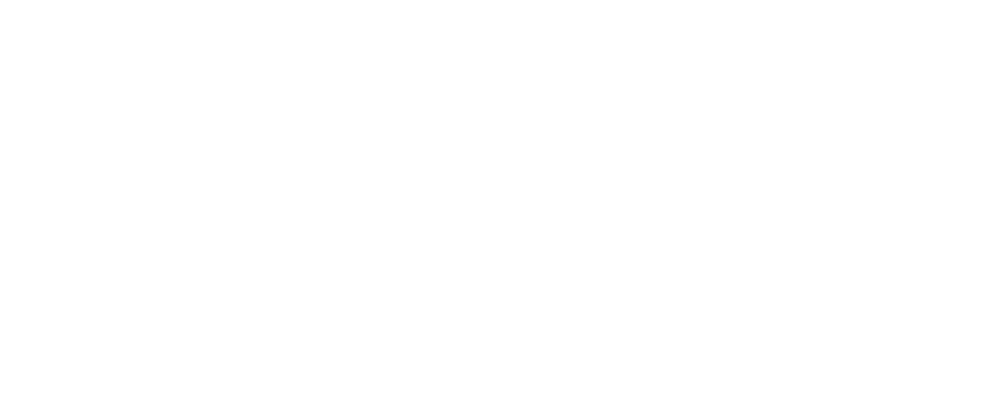

helpers.py:298: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return ' '.join(labels_desc[label_i].split(',')[0].split()[1:])


IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [58]:
interested_idx = [#10, # Pomeranian (Pekinese)
                  #79, # loud speaker (CD player)
                  #11, # water ouzel (cliff)
                  #17, # street sign
                  #12, # chocolate sauce
                  90, 
                 ]
for i in interested_idx:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    visualize_heatmaps(net, img_path, mask_path, ann_path, label, show_bbs = False, mask_alpha = mask_alpha, mask_flip = True, thres_first = True, gpu = None,
                           synsets = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synsets.txt', str, delimiter='\t'),
                           indexing = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/ascii_order_to_synset_order.txt'))

<IPython.core.display.Javascript object>


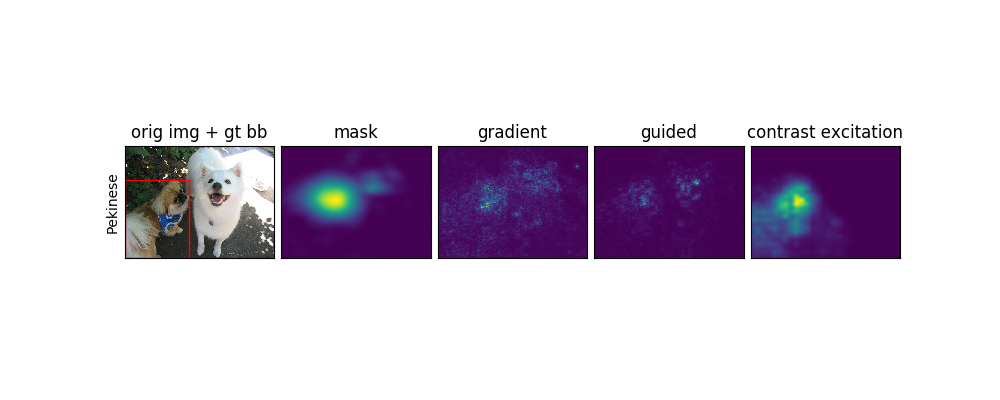

<IPython.core.display.Javascript object>


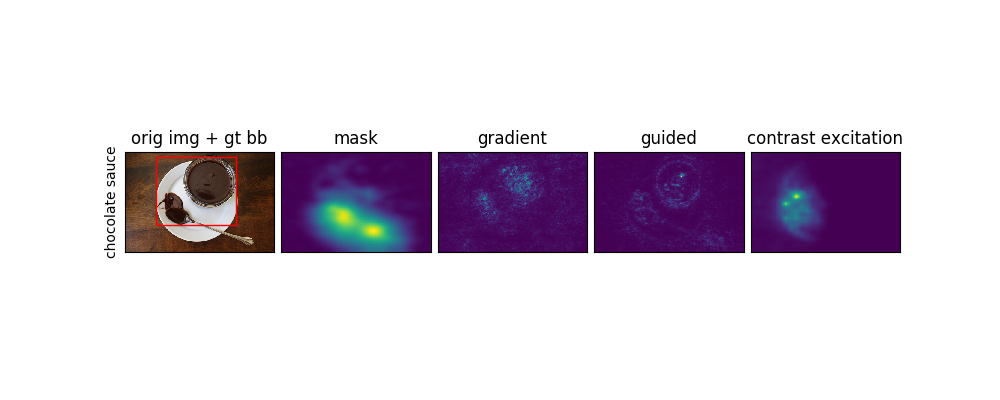

In [73]:
interested_idx = [10, # Pomeranian
                  12, # chocolate sauce
                 ]
for i in interested_idx:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    fig_path = None
    fig_path = os.path.join(fig_dir, 'compare_saliency_%d_w_titles.pdf' % i)
    visualize_heatmaps(net, img_path, mask_path, label, ann_path = ann_path, show_titles = True, 
                       show_bbs = False, mask_flip = True, thres_first = True, fig_path = fig_path, gpu = gpu)

In [6]:
interested_idx = np.random.choice(5000, 10, replace=False)
print interested_idx

[2491  438 4982 4422  239 2787  630  747  145 3169]


<IPython.core.display.Javascript object>


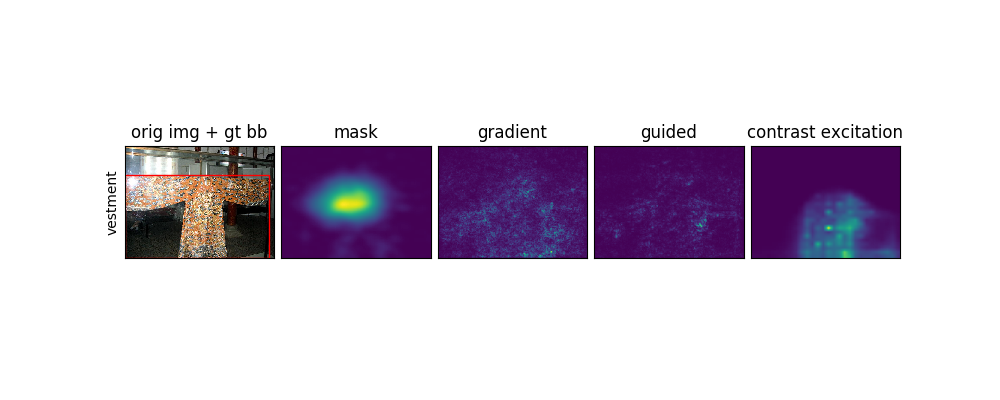

In [9]:
for i in [interested_idx[0]]:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    fig_path = None
    fig_path = os.path.join(fig_dir, 'compare_saliency_%d_random_w_title.pdf' % i)
    visualize_heatmaps(net, img_path, mask_path, label, ann_path = ann_path, show_titles = True, 
                       show_bbs = False, mask_flip = True, thres_first = True, fig_path = fig_path, gpu = gpu)

<IPython.core.display.Javascript object>


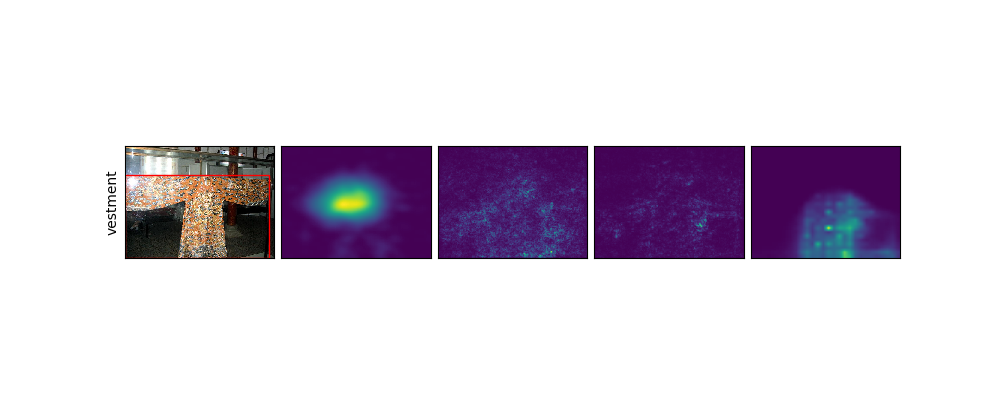

<IPython.core.display.Javascript object>


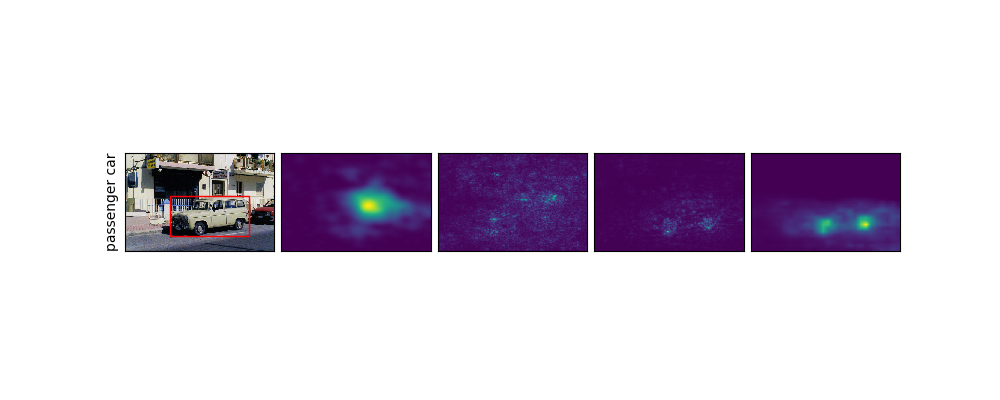

<IPython.core.display.Javascript object>


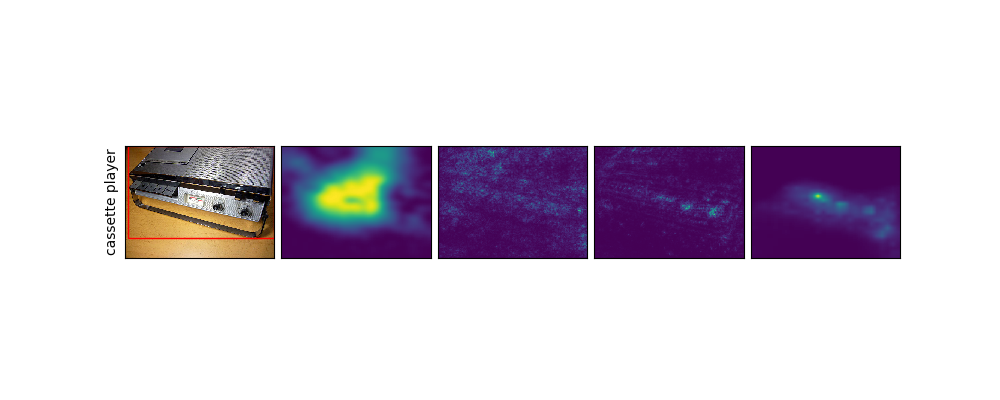

<IPython.core.display.Javascript object>


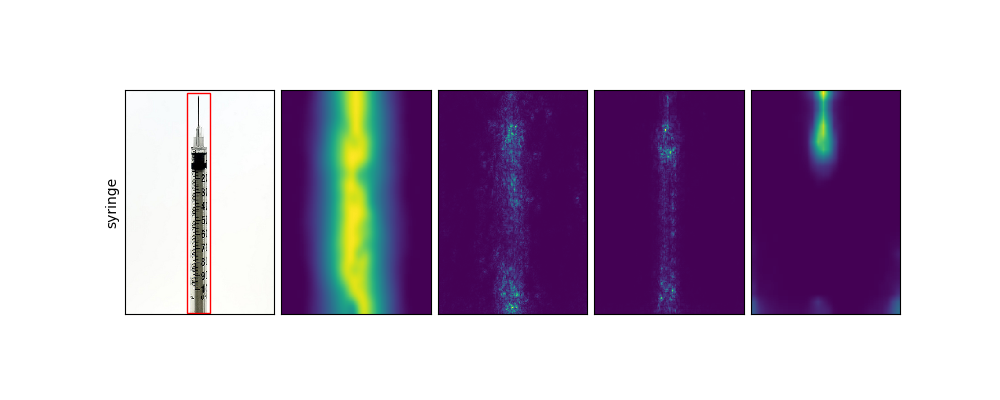

<IPython.core.display.Javascript object>


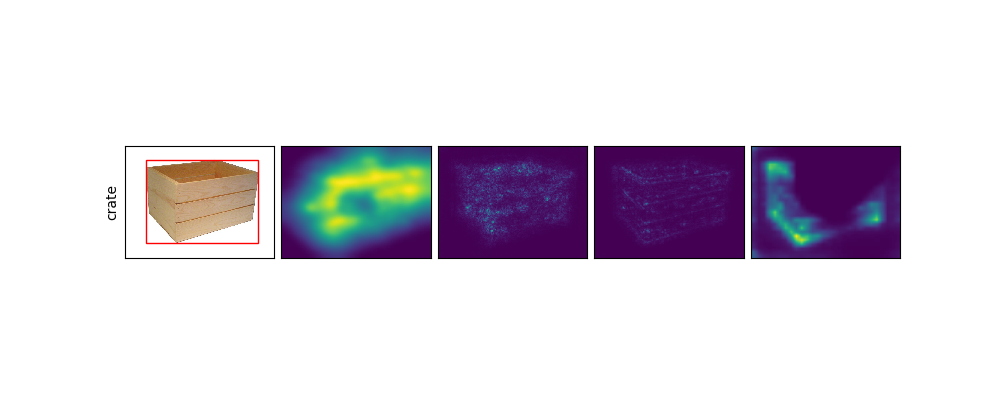

<IPython.core.display.Javascript object>


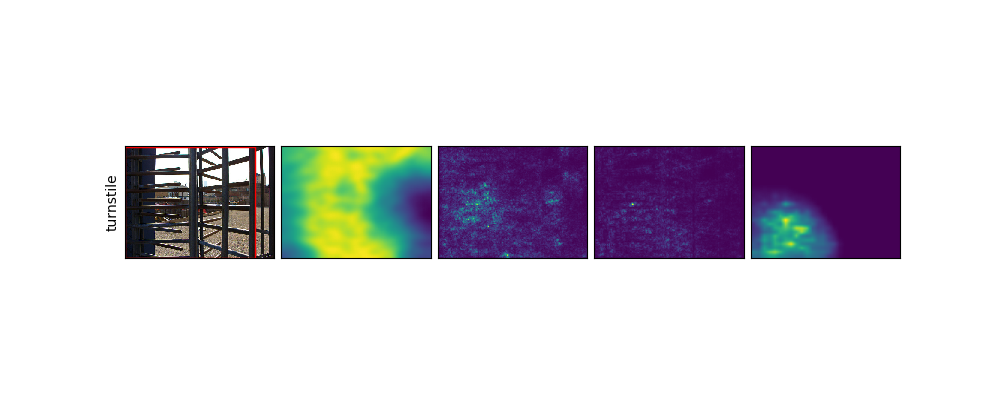

<IPython.core.display.Javascript object>


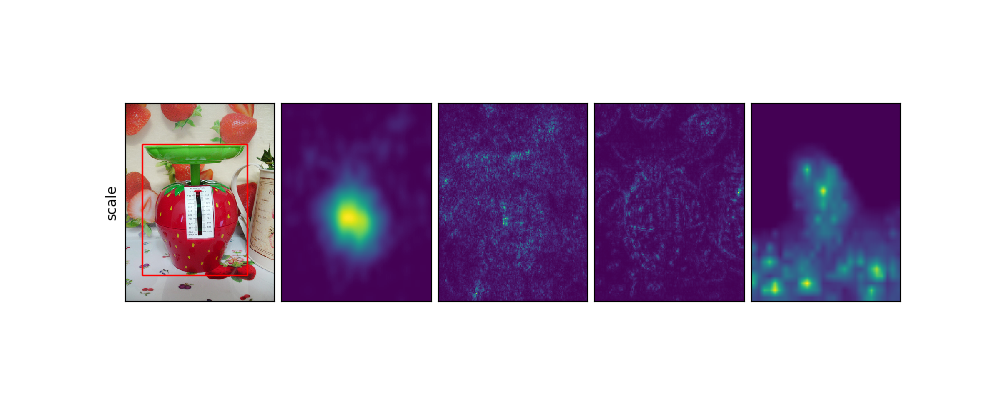

<IPython.core.display.Javascript object>


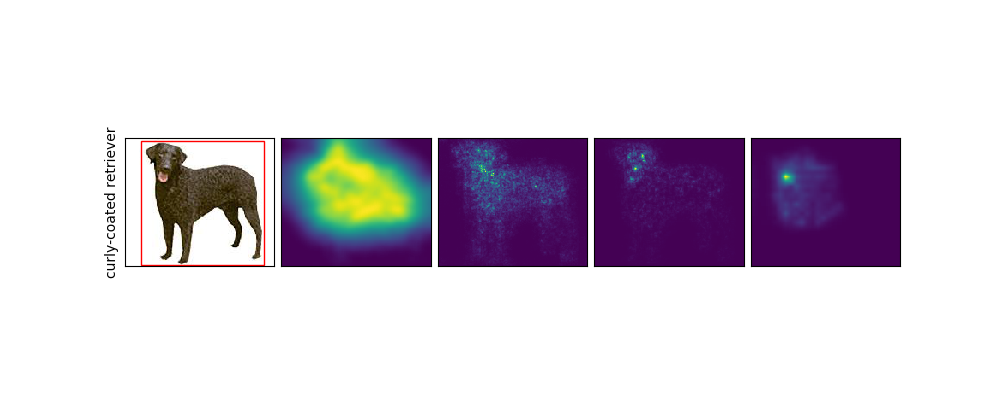

<IPython.core.display.Javascript object>


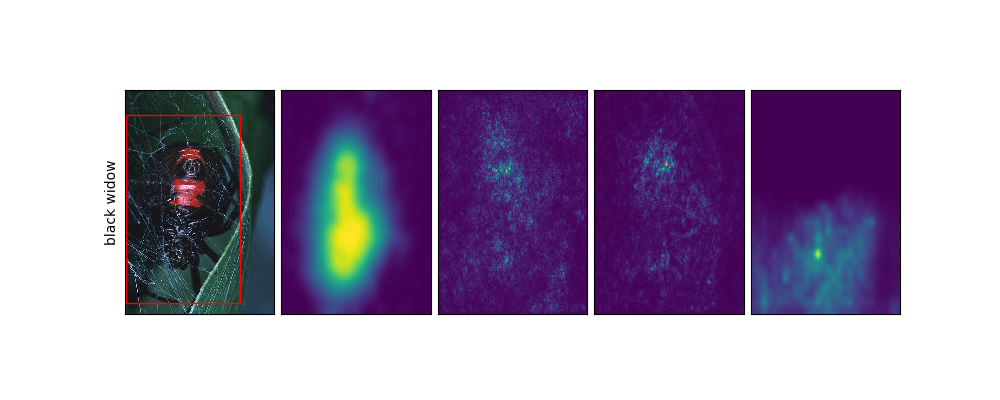

<IPython.core.display.Javascript object>


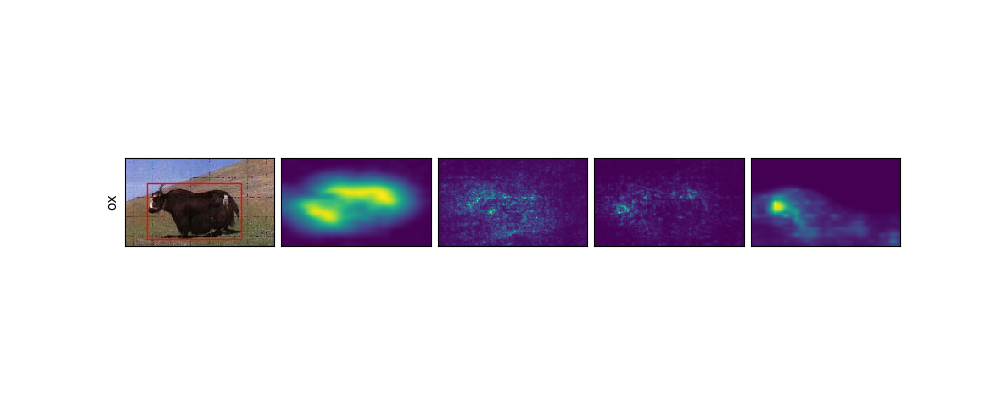

In [7]:
for i in interested_idx:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    fig_path = None
    fig_path = os.path.join(fig_dir, 'compare_saliency_%d_random.pdf' % i)
    visualize_heatmaps(net, img_path, mask_path, label, ann_path = ann_path, show_titles = False, 
                       show_bbs = False, mask_flip = True, thres_first = True, fig_path = fig_path, gpu = gpu)

In [10]:
mask_rel_dir_top0 = 'googlenet_train_heldout_given_grad_1_norm_0/min_top0_prob_blur/lr_-1.00_l1_lambda_-4.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_3.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
mask_paths_top0 = [os.path.join(res_dir, mask_rel_dir_top0, '%d.npy' % x) for x in range(len(labels))]

mask_rel_dir_top5 = 'googlenet_train_heldout_given_grad_1_norm_0/min_top5_prob_blur/lr_-1.00_l1_lambda_-3.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_2.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
mask_paths_top5 = [os.path.join(res_dir, mask_rel_dir_top5, '%d.npy' % x) for x in range(len(labels))]

In [22]:
def visualize_multiple_masks(net, img_path, mask_paths, label, ann_path = None, show_titles = True, 
                             mask_flip = True, mask_titles = ['min target class', 'min top5 predicted classes'], fig_path = None):
    if show_titles:
        assert(len(mask_titles) == len(mask_paths))
    f, ax = plt.subplots(1, 1 + len(mask_paths))
    ax[0].imshow(caffe.io.load_image(img_path))
    if show_titles:
        ax[0].set_title('orig img + gt bb')
    ax[0].set_ylabel(get_short_class_name(label))
    ax[0].get_xaxis().set_visible(False)
    ax[0].get_yaxis().set_ticks([])
    if ann_path != None:
        objs = load_objs(ann_path)
        for k in objs.keys():
            for i in range(len(objs[k])):
                bb_coords = objs[k][i]
                rect = patches.Rectangle((bb_coords[0],bb_coords[1]),bb_coords[2]-bb_coords[0],bb_coords[3]-bb_coords[1],
                             linewidth=1,edgecolor='r',facecolor='none')
                ax[0].add_patch(rect)
    
    transformer = get_ILSVRC_net_transformer(net)
    resize = caffe.io.load_image(img_path).shape[:2]
    for i in range(len(mask_paths)):
        mask_path = mask_paths[i]
        heatmap = np.load(mask_path)
        if mask_flip:
            heatmap = 1 - heatmap
        ax[i+1].imshow(imresize(heatmap, resize))
        if show_titles:
            ax[i+1].set_title(mask_titles[i])
        ax[i+1].get_xaxis().set_visible(False)
        ax[i+1].get_yaxis().set_visible(False)
        
    f.subplots_adjust(wspace=0.05,hspace=0)
    #plt.tight_layout()

    if fig_path != None:
        plt.savefig(fig_path, bbox_inches='tight', pad_inches=0.0)

In [17]:
interested_idx = np.random.choice(5000, 20, replace=False)
print interested_idx

[2698 4604 2761  552 3146 2976 4982  742 3198 3584 2111 1426  944  141  494
 2789 2389 2333 1951 4554]


<IPython.core.display.Javascript object>


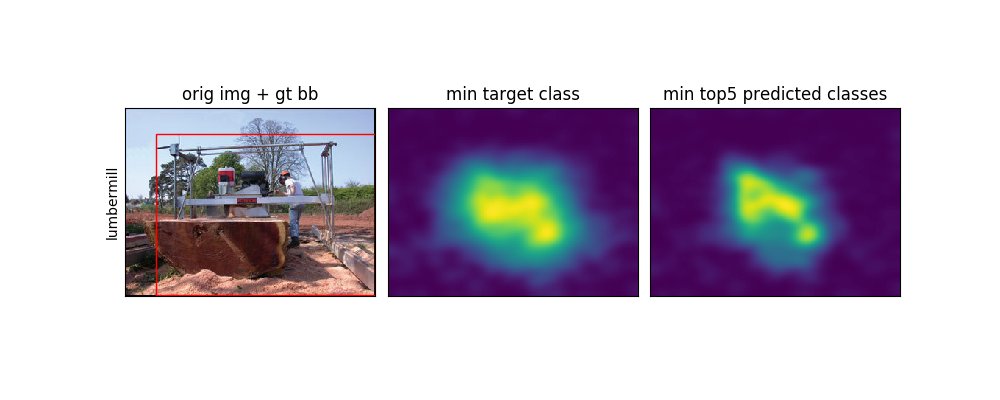

<IPython.core.display.Javascript object>


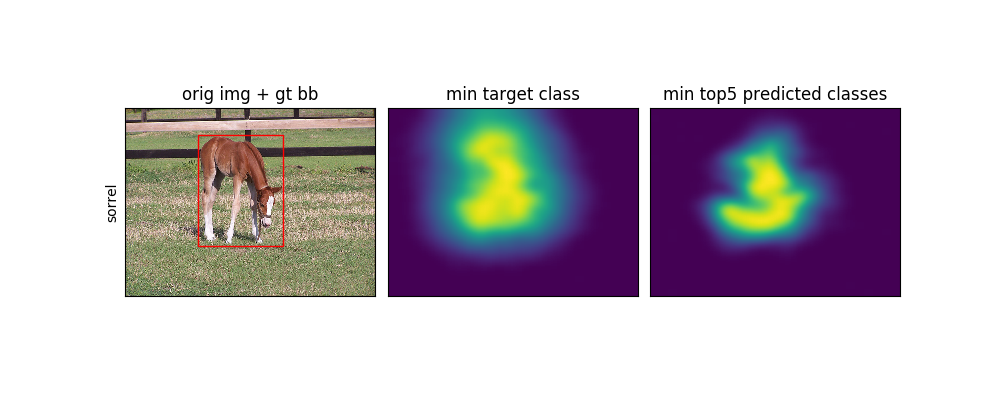

In [23]:
for i in [141, 1951]:
    img_path = paths[i]
    mask_ps = [mask_paths_top0[i], mask_paths_top5[i]]
    ann_path = ann_paths[i]
    label = labels[i]
    fig_path = None
    fig_path = os.path.join(fig_dir, 'compare_saliency_%d_random_mult_masks_w_title.pdf' % i)
    visualize_multiple_masks(net, img_path, mask_ps, label, ann_path = ann_path, show_titles = True, 
                       mask_flip = True, fig_path = fig_path)

<IPython.core.display.Javascript object>


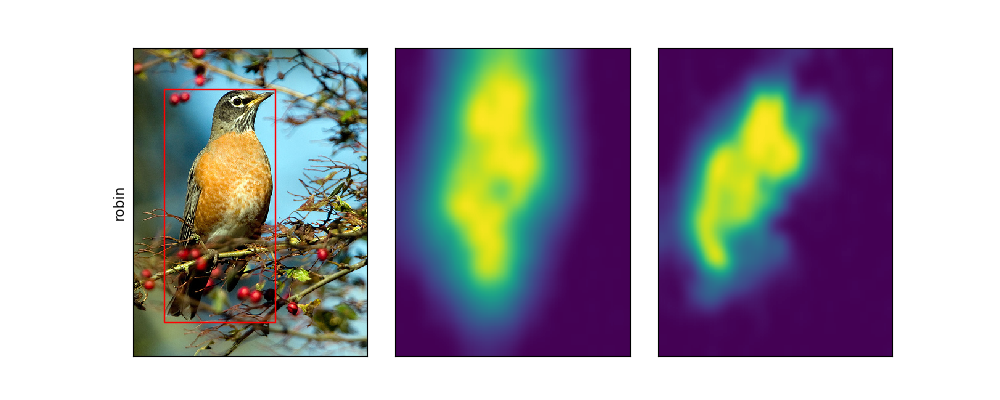

<IPython.core.display.Javascript object>


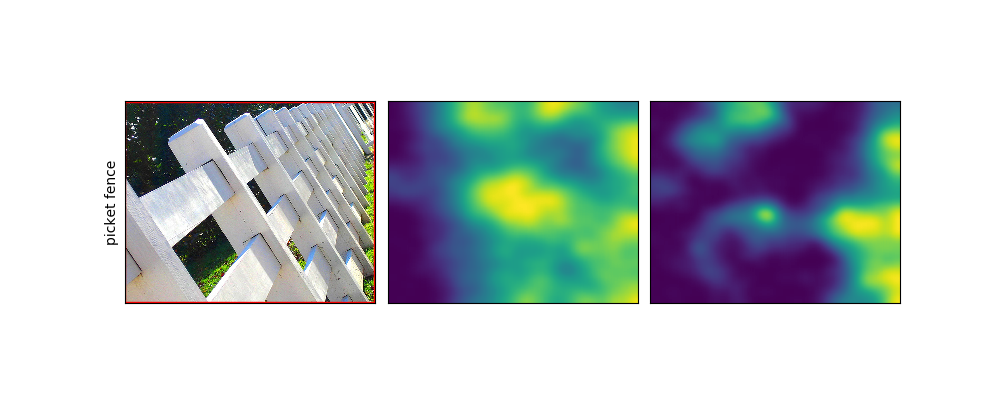

<IPython.core.display.Javascript object>


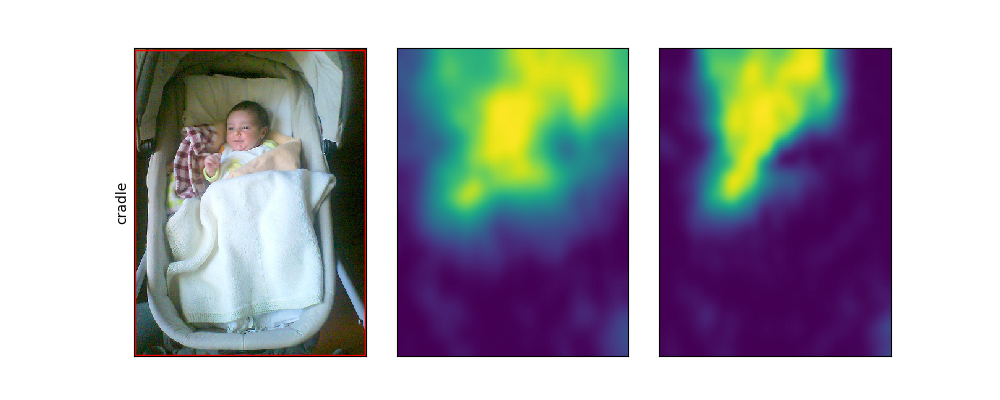

<IPython.core.display.Javascript object>


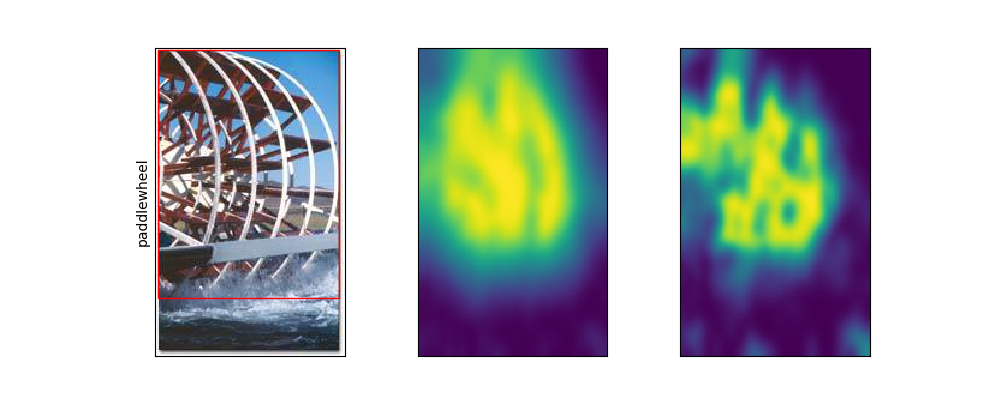

<IPython.core.display.Javascript object>


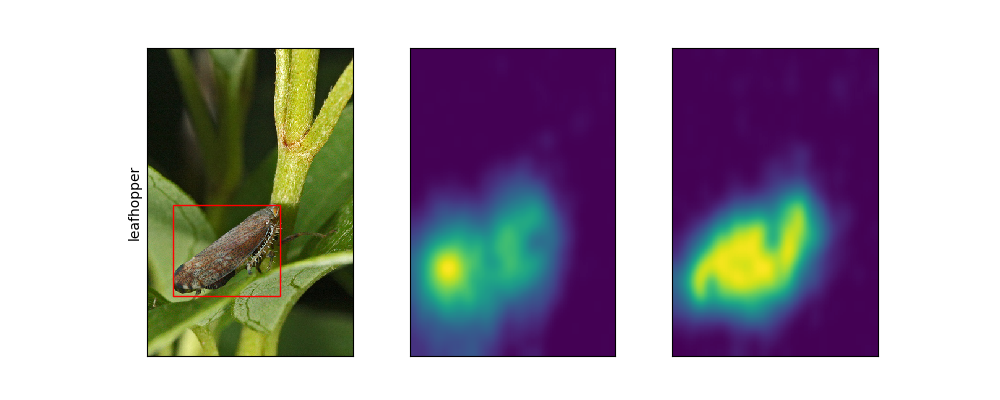

<IPython.core.display.Javascript object>


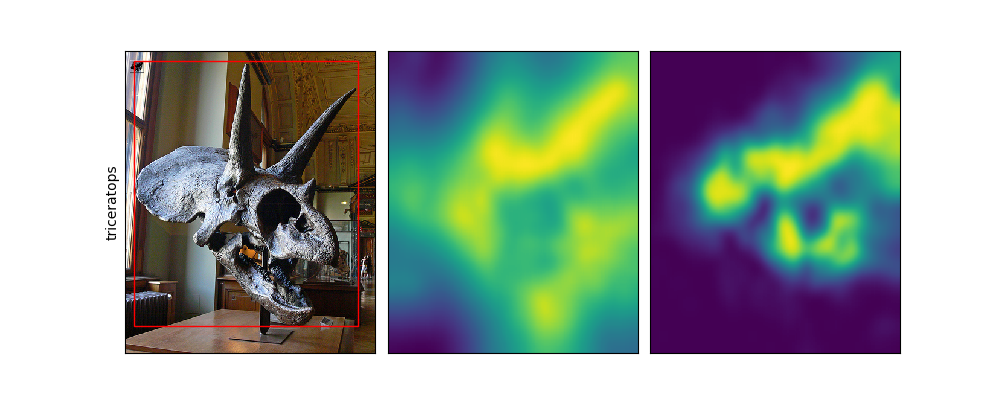

<IPython.core.display.Javascript object>


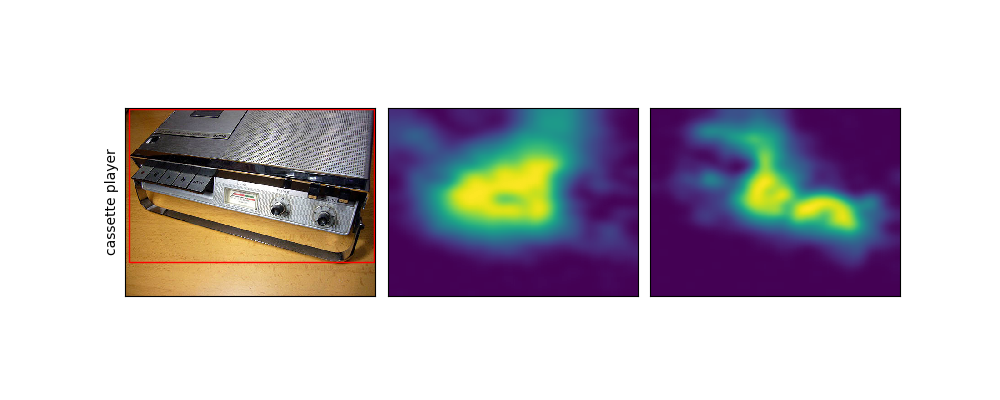

<IPython.core.display.Javascript object>


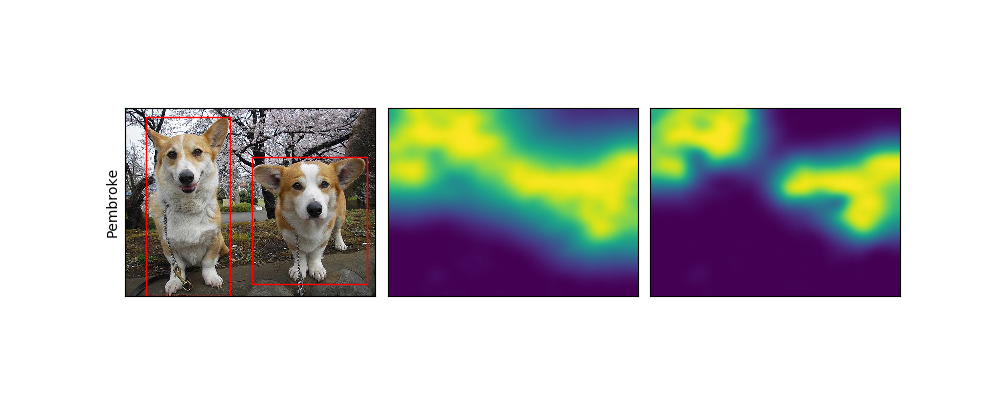

<IPython.core.display.Javascript object>


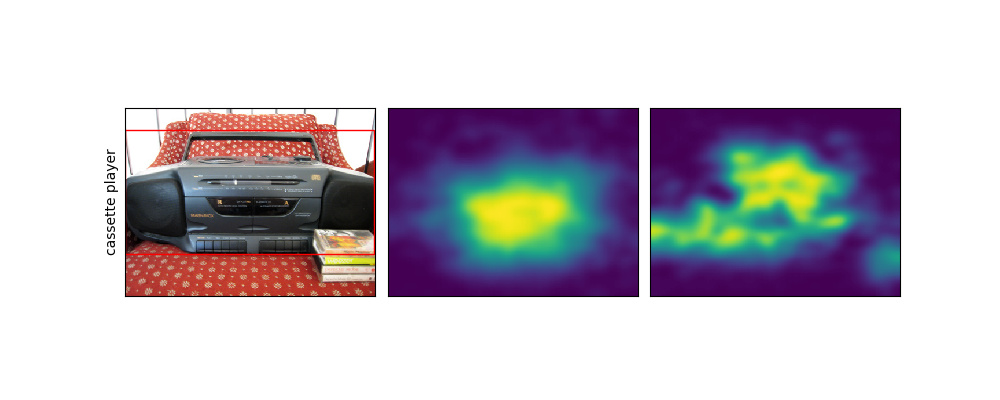

<IPython.core.display.Javascript object>


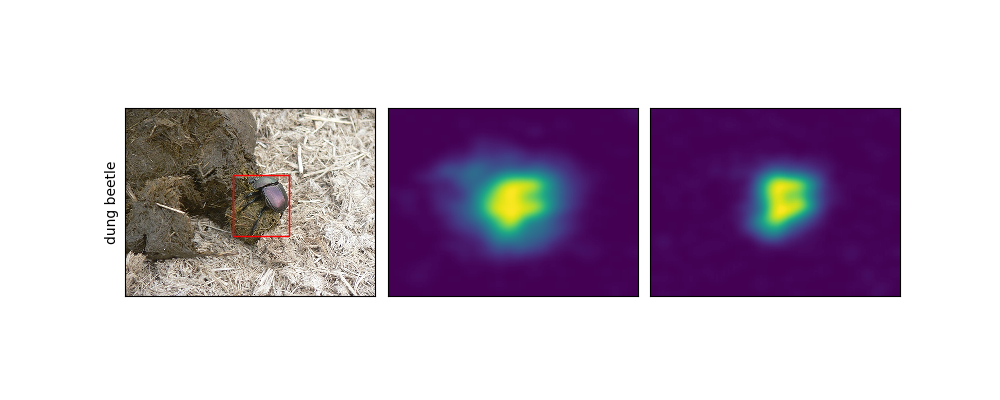

<IPython.core.display.Javascript object>


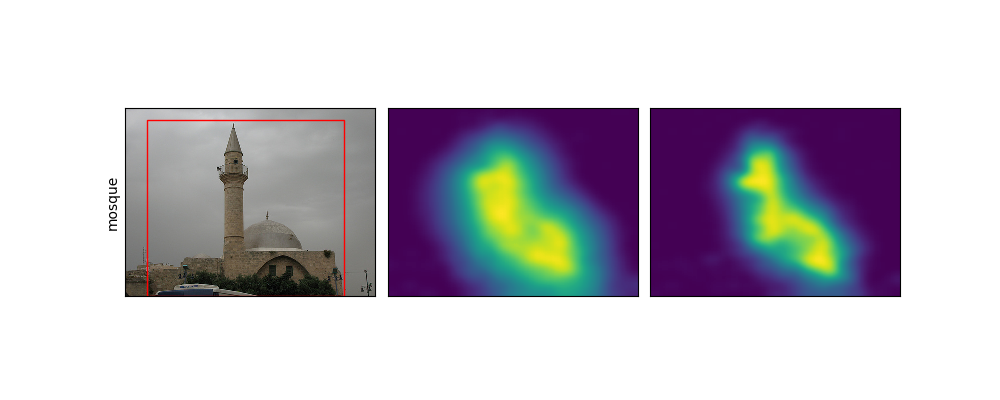

<IPython.core.display.Javascript object>


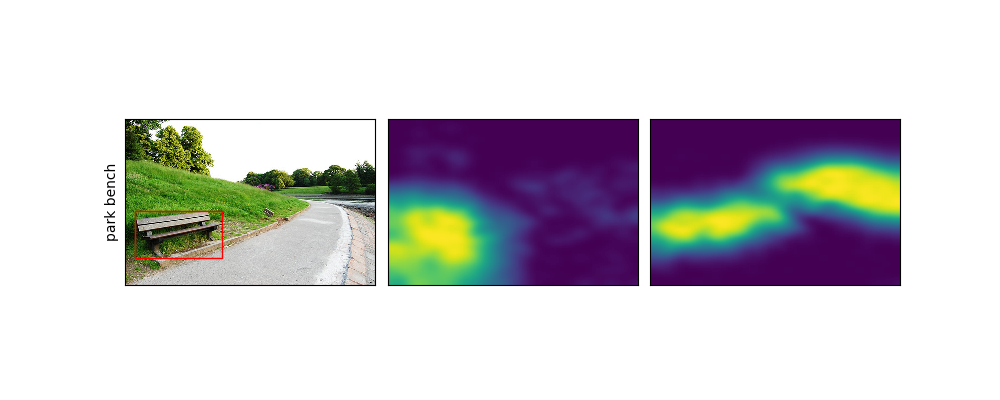

<IPython.core.display.Javascript object>


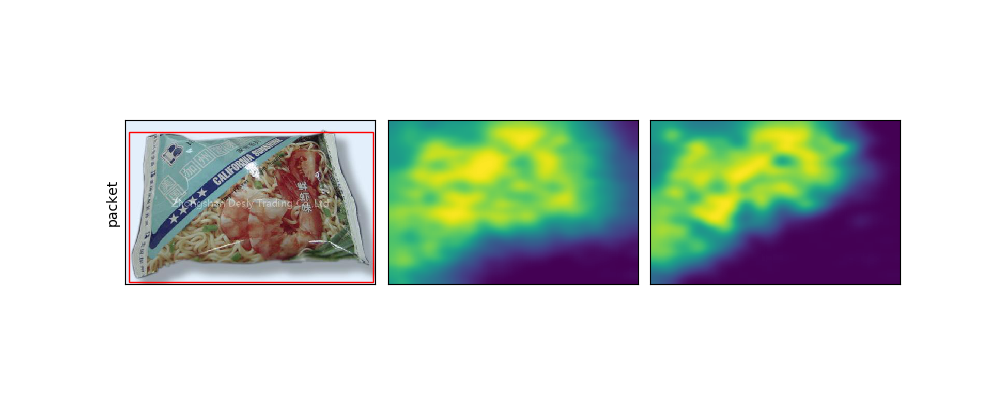

<IPython.core.display.Javascript object>


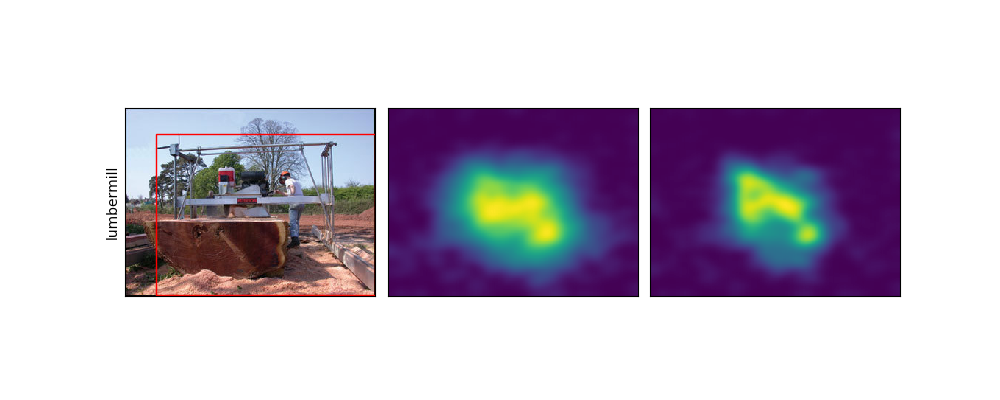

<IPython.core.display.Javascript object>


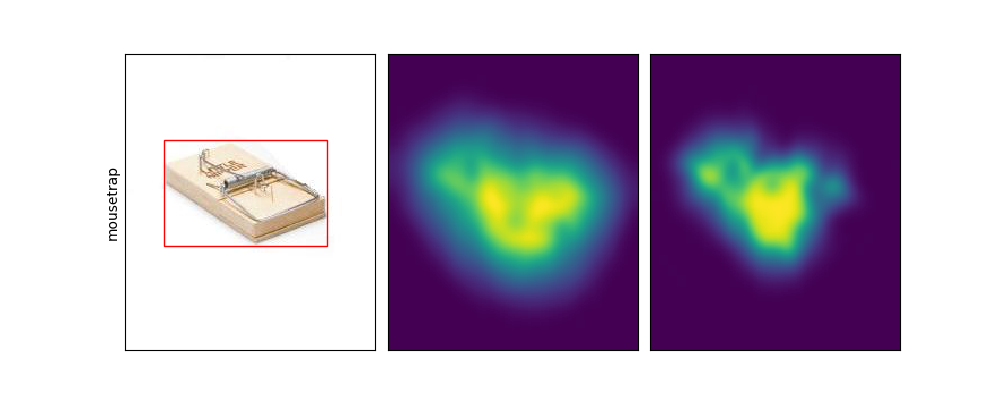

<IPython.core.display.Javascript object>


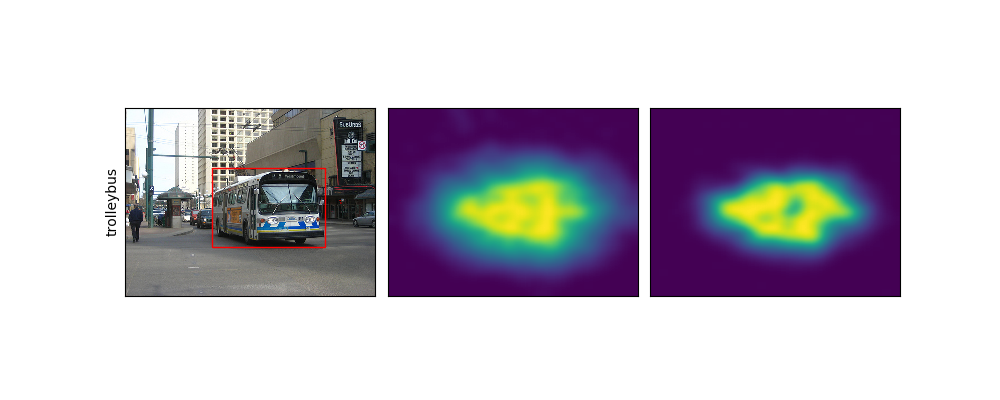

<IPython.core.display.Javascript object>


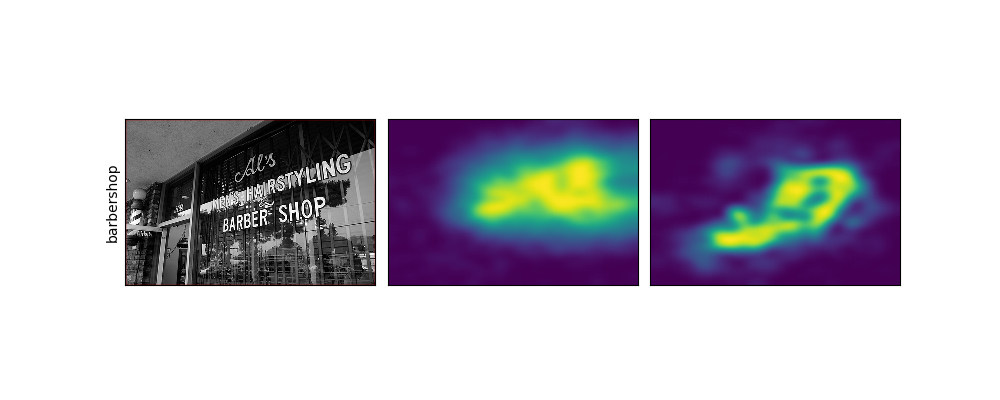

<IPython.core.display.Javascript object>


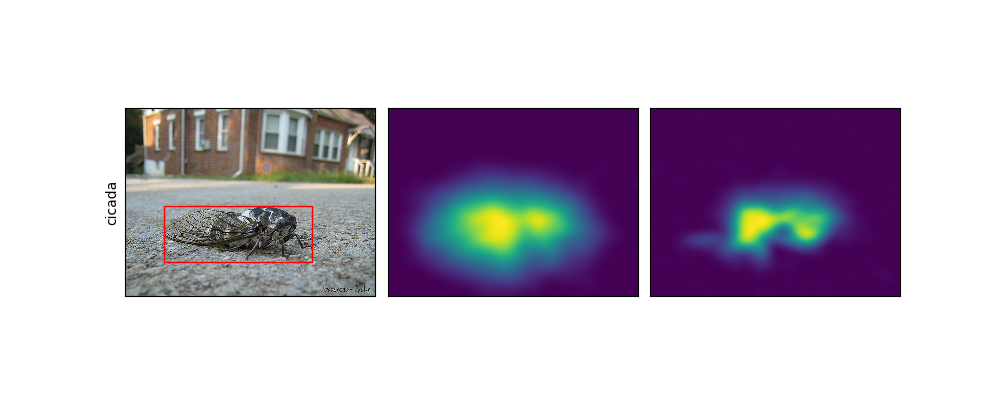

<IPython.core.display.Javascript object>


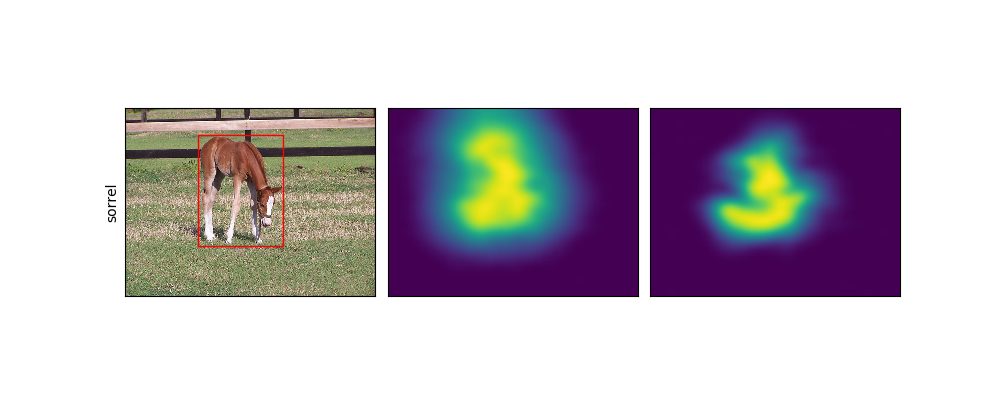

<IPython.core.display.Javascript object>


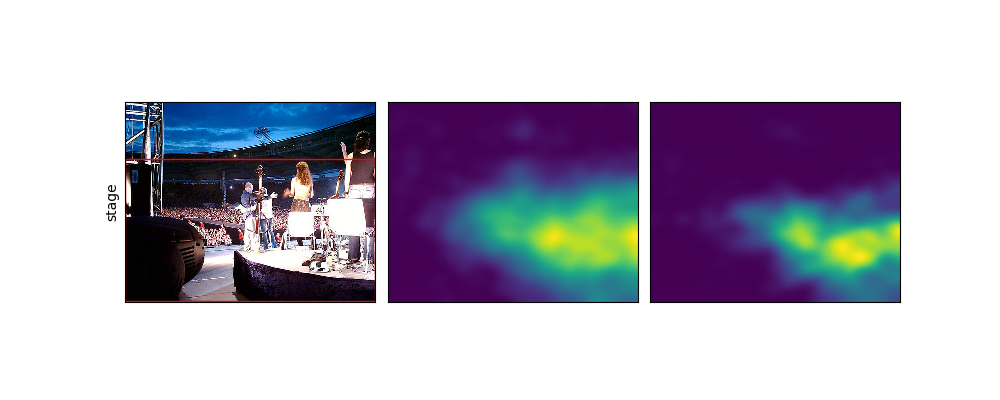

In [18]:
for i in interested_idx:
    img_path = paths[i]
    mask_ps = [mask_paths_top0[i], mask_paths_top5[i]]
    ann_path = ann_paths[i]
    label = labels[i]
    fig_path = None
    fig_path = os.path.join(fig_dir, 'compare_saliency_%d_random_mult_masks.pdf' % i)
    visualize_multiple_masks(net, img_path, mask_ps, label, ann_path = ann_path, show_titles = False, 
                       mask_flip = True, fig_path = fig_path)

<IPython.core.display.Javascript object>


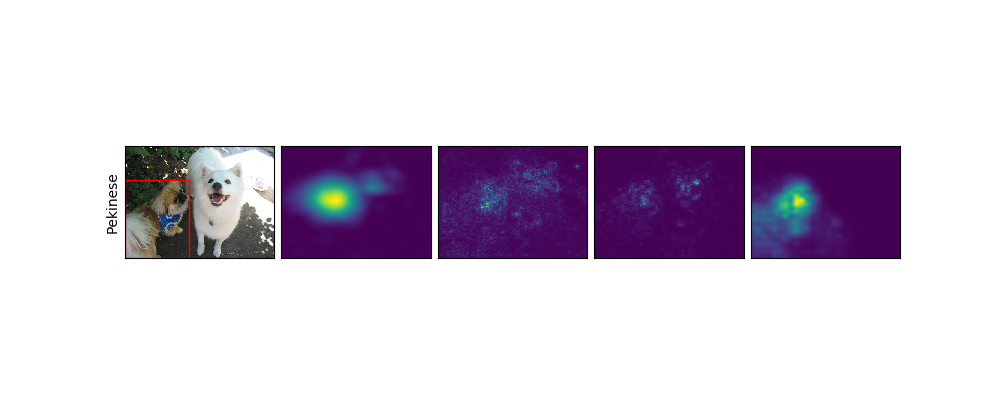

<IPython.core.display.Javascript object>


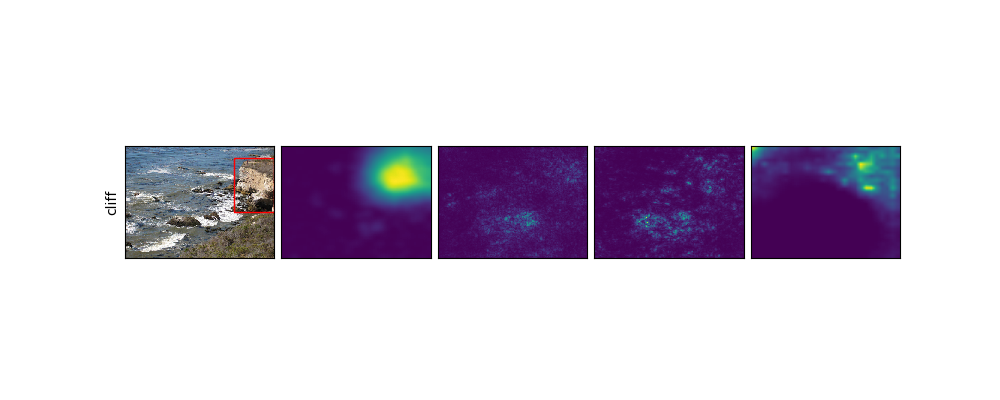

<IPython.core.display.Javascript object>


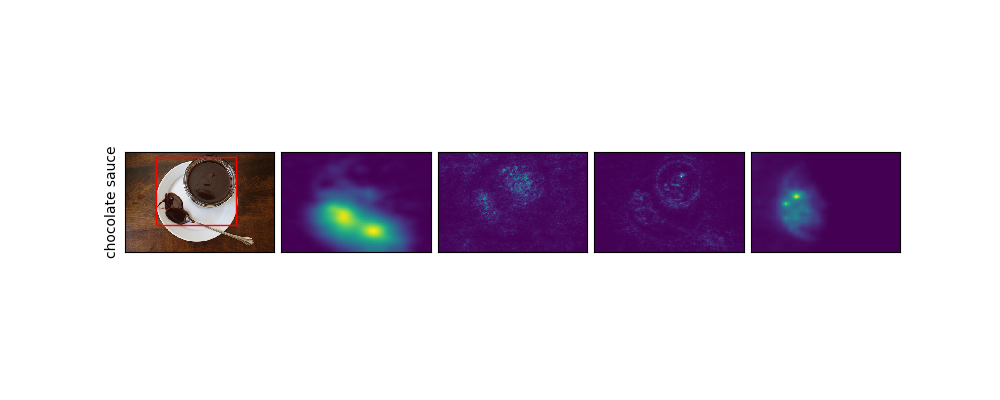

<IPython.core.display.Javascript object>


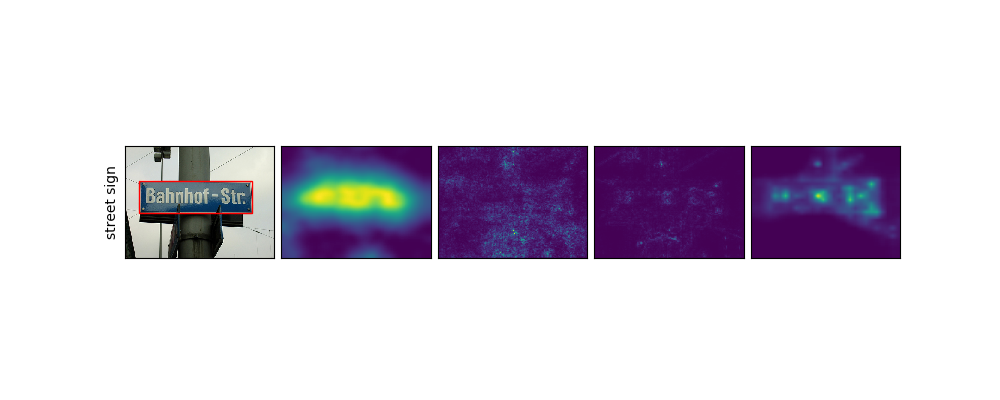

<IPython.core.display.Javascript object>


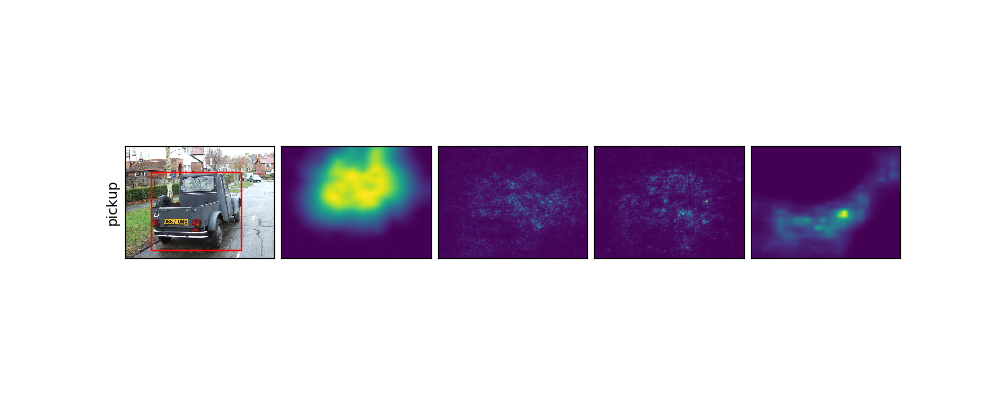

<IPython.core.display.Javascript object>


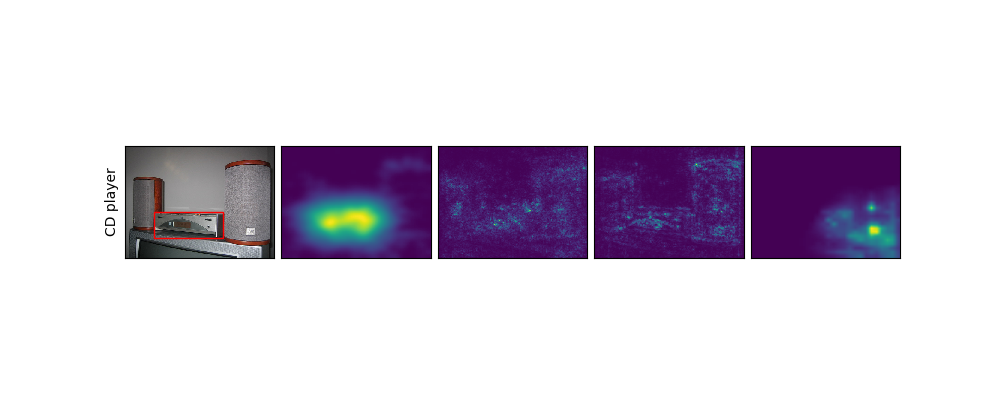

<IPython.core.display.Javascript object>


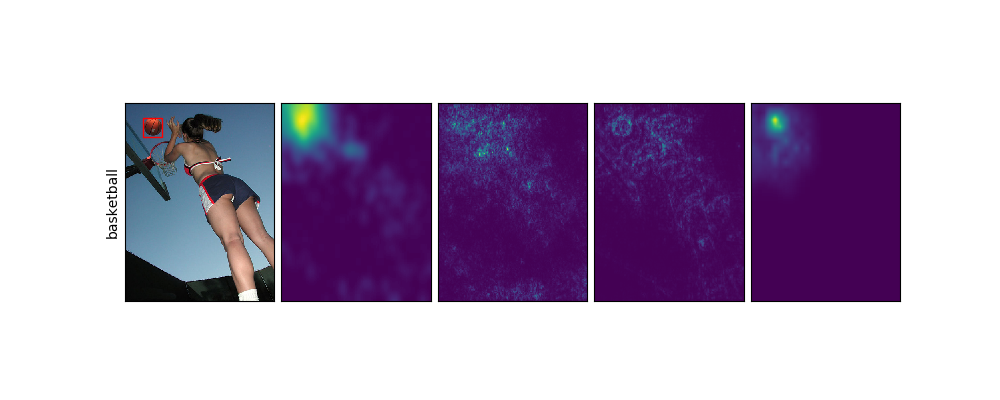

<IPython.core.display.Javascript object>


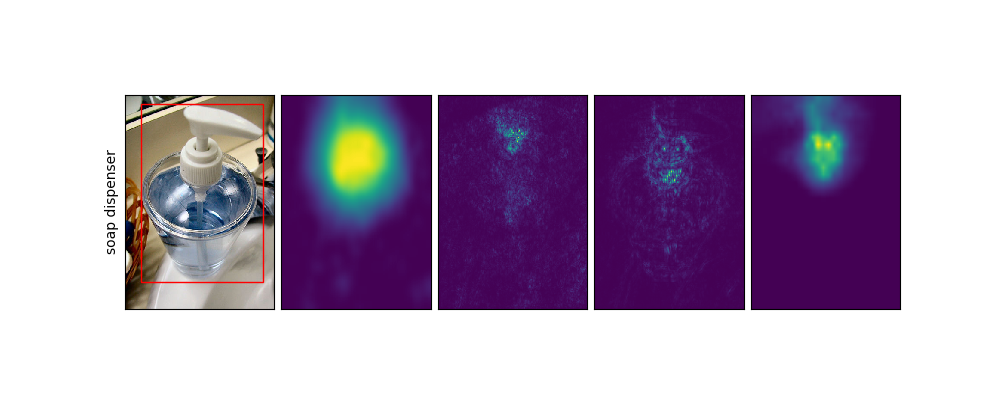

<IPython.core.display.Javascript object>


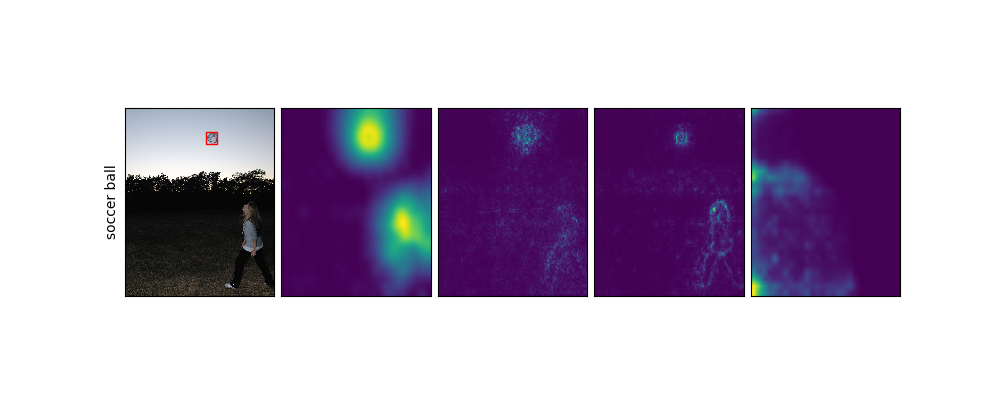

<IPython.core.display.Javascript object>


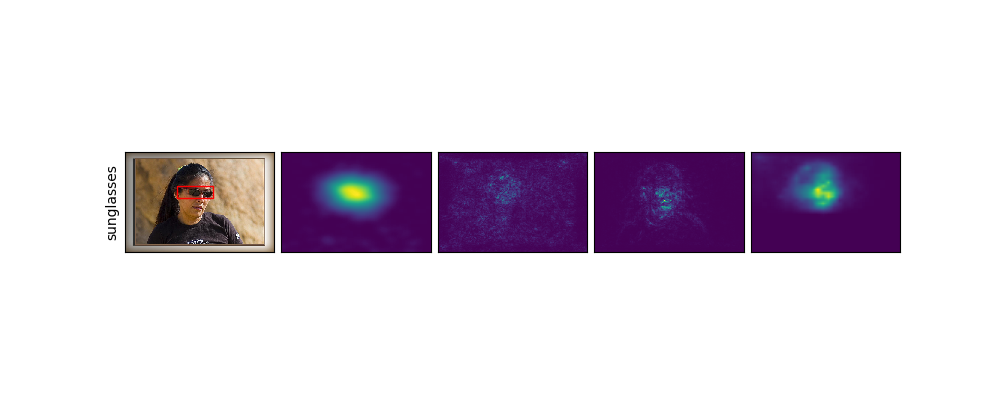

<IPython.core.display.Javascript object>


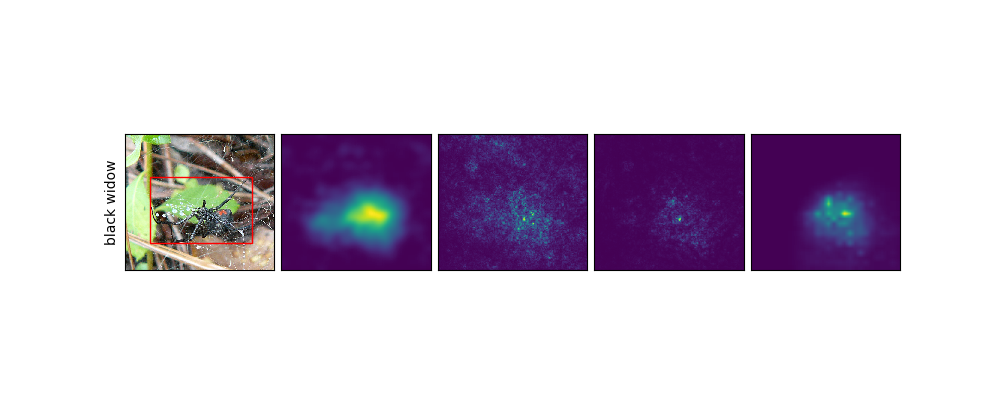

<IPython.core.display.Javascript object>


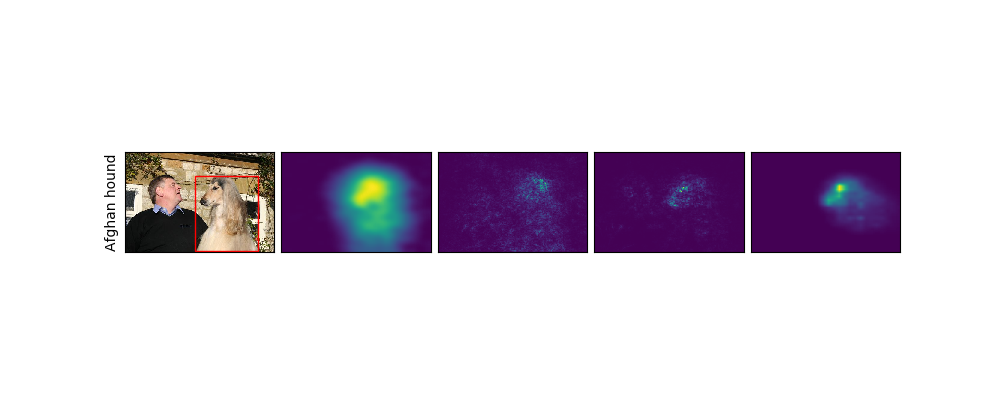

<IPython.core.display.Javascript object>


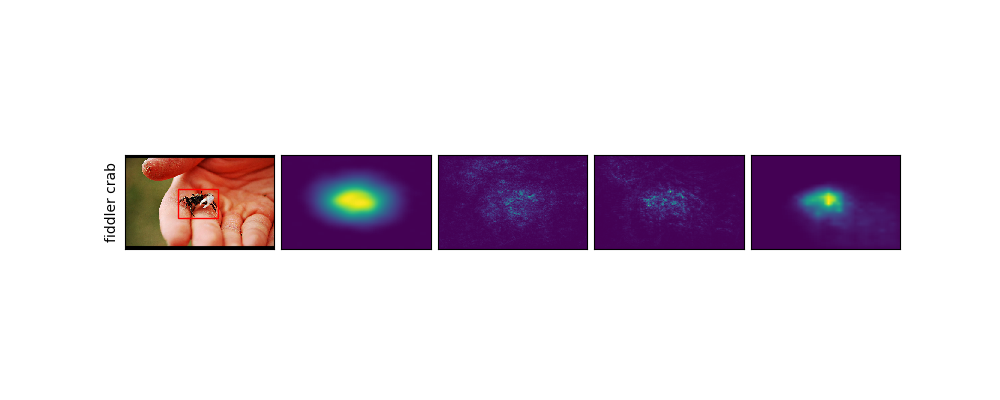

<IPython.core.display.Javascript object>


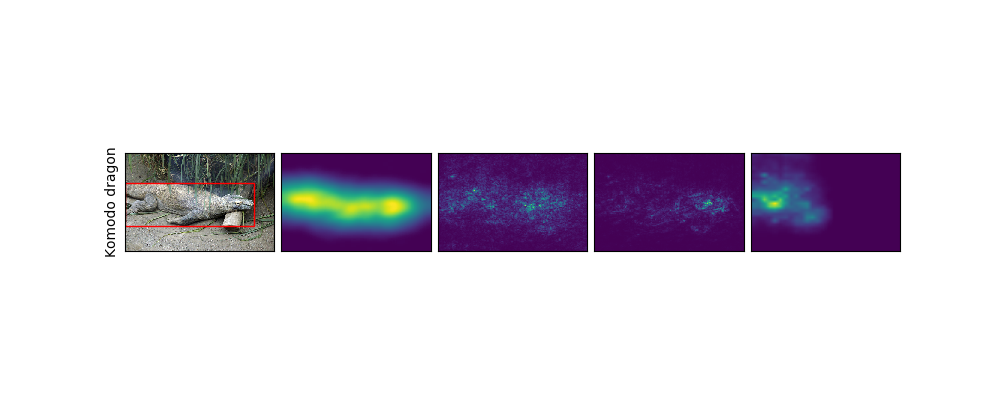

<IPython.core.display.Javascript object>


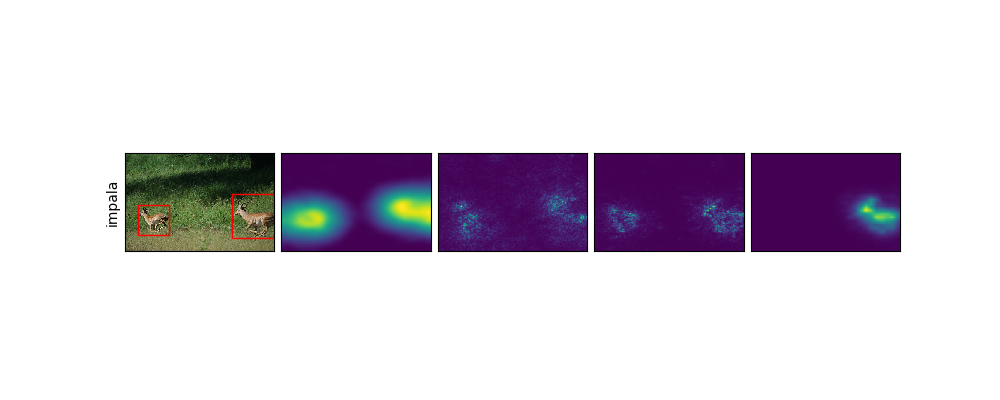

<IPython.core.display.Javascript object>


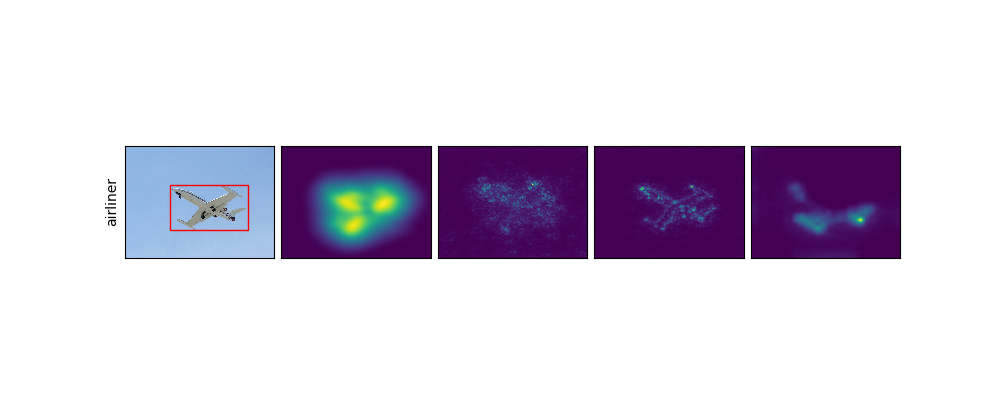

<IPython.core.display.Javascript object>


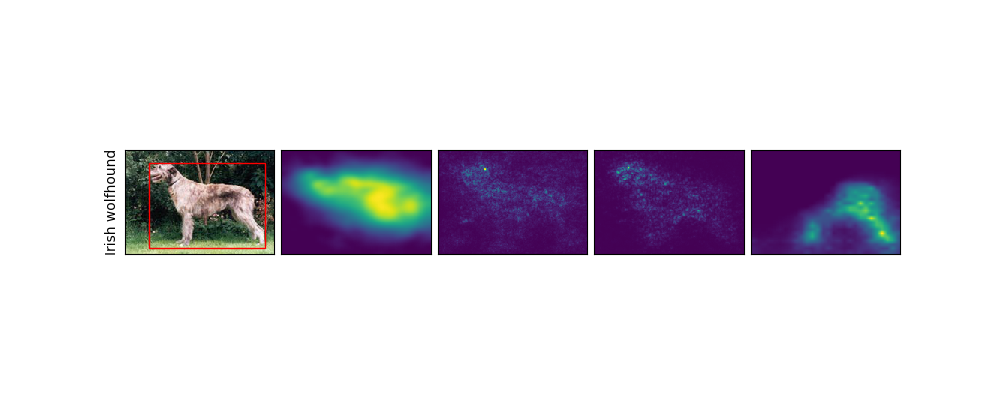

<IPython.core.display.Javascript object>


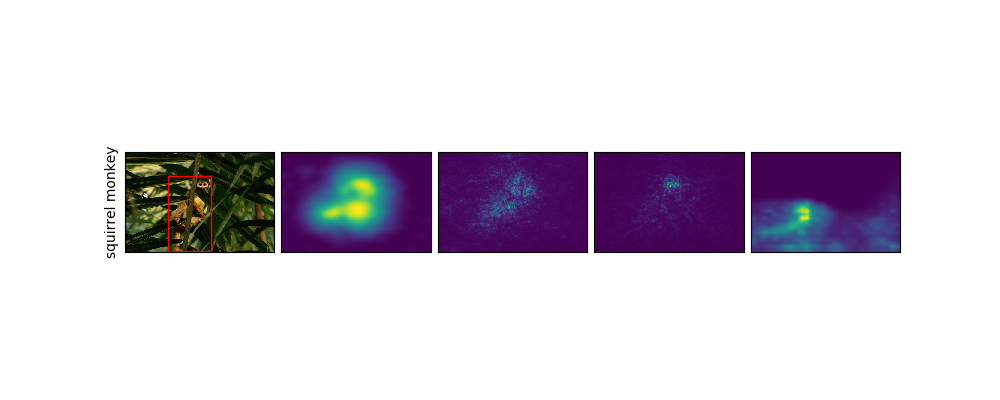

In [71]:
interested_idx = [10, # Pomeranian
                  11, # water ouzel
                  12, # chocolate sauce
                  17, # street sign
                  #25, # rugby ball
                  30, # pickup truck
                  #40, # bonnet
                  #44, # Chihuahua
                  #48, # pill bottle
                  79, # loud speaker
                  #86, # rugby ball
                  #88, # sturgeon,
                  150, 
                  #170, 
                  199, 
                  #206, 
                  263, 
                  #301, 
                  #311, 
                  322, 
                  #327, 
                  #363, 
                  #371,
                  90,100,147,151,156,161,175,186
                 ]
#interested_idx = [90,100,147]
#interested_idx = [151,156,161,175,186]
#interested_idx = range(150,200)
for i in interested_idx:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    fig_path = None
    fig_path = os.path.join(fig_dir, 'compare_saliency_%d.pdf' % i)
    visualize_heatmaps(net, img_path, mask_path, label, ann_path = ann_path, show_titles = False, 
                       show_bbs = False, mask_flip = True, thres_first = True, fig_path = fig_path, gpu = gpu)

<IPython.core.display.Javascript object>


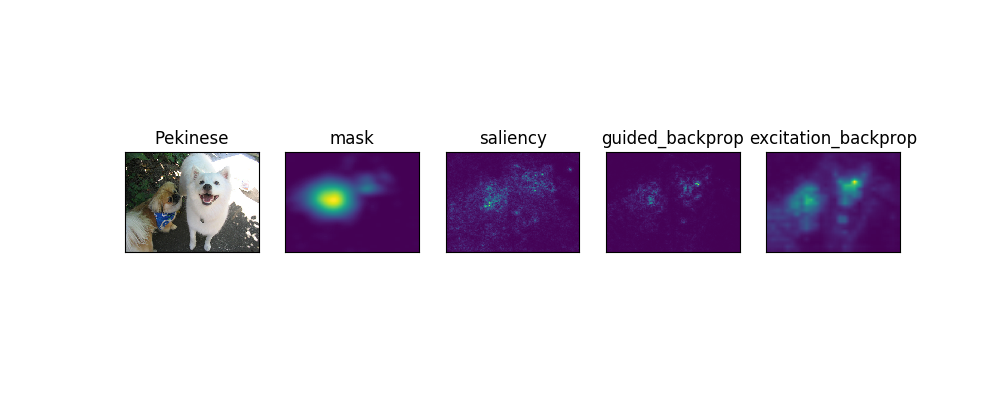

<IPython.core.display.Javascript object>


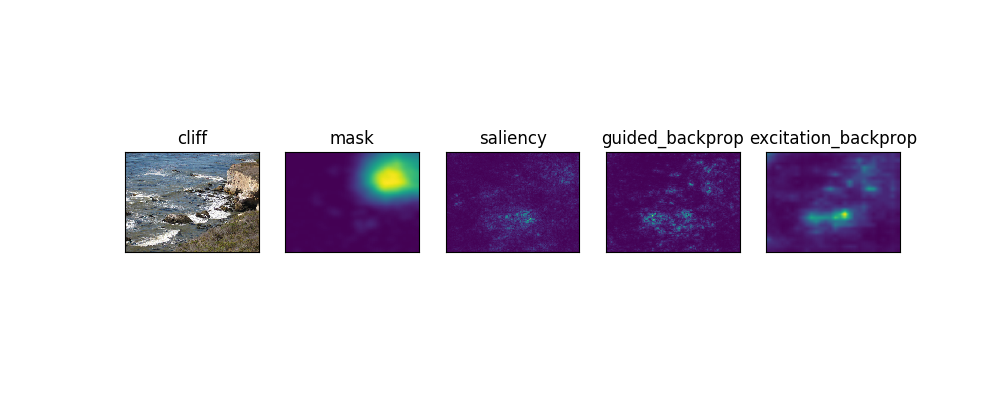

<IPython.core.display.Javascript object>


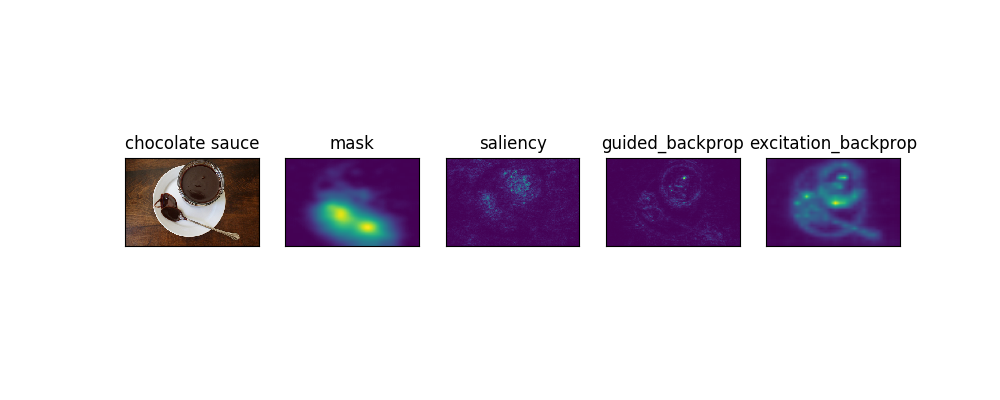

<IPython.core.display.Javascript object>


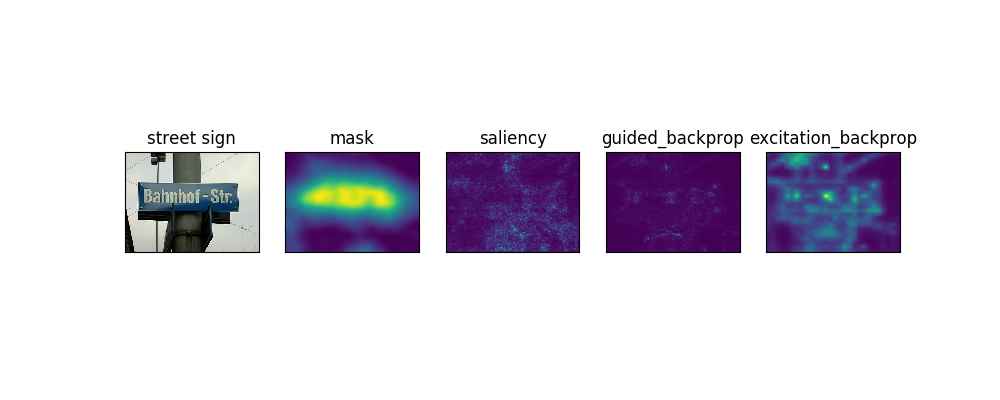

<IPython.core.display.Javascript object>


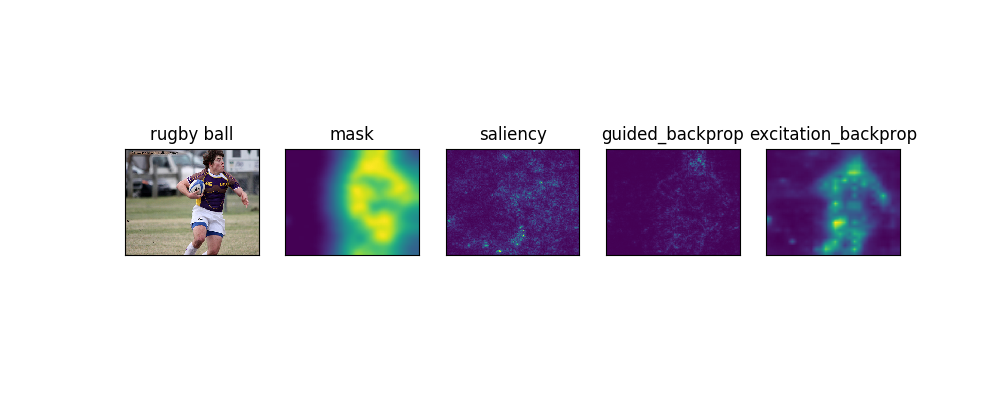

<IPython.core.display.Javascript object>


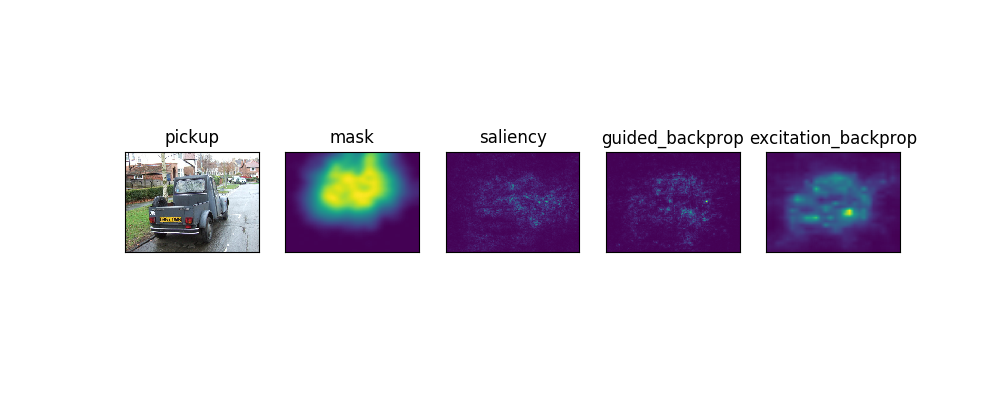

<IPython.core.display.Javascript object>


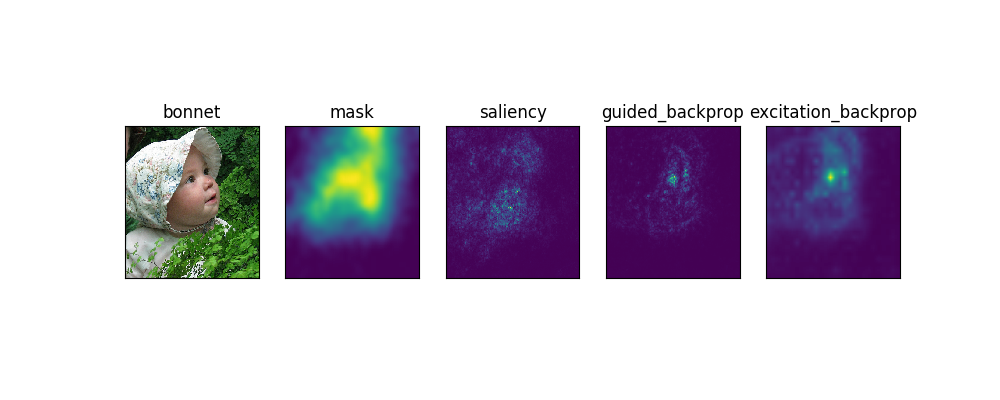

<IPython.core.display.Javascript object>


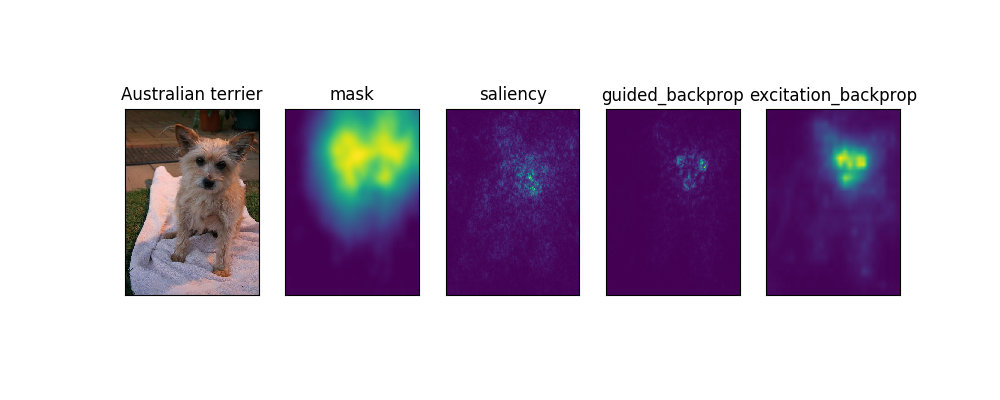

<IPython.core.display.Javascript object>


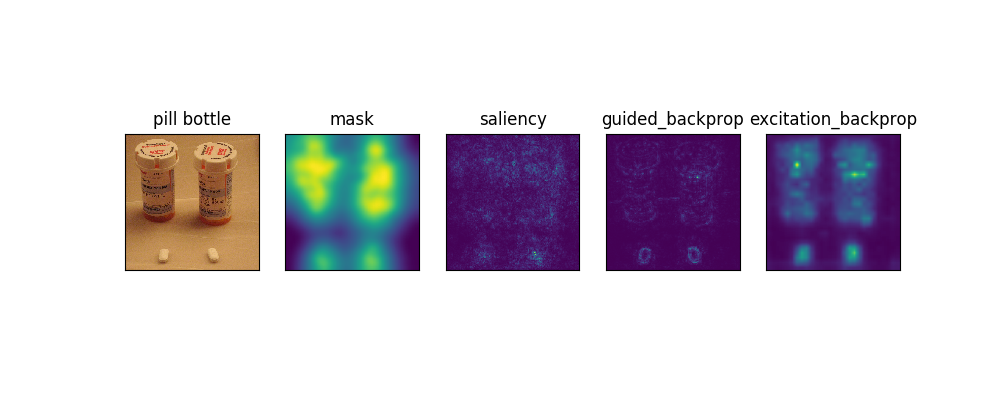

<IPython.core.display.Javascript object>


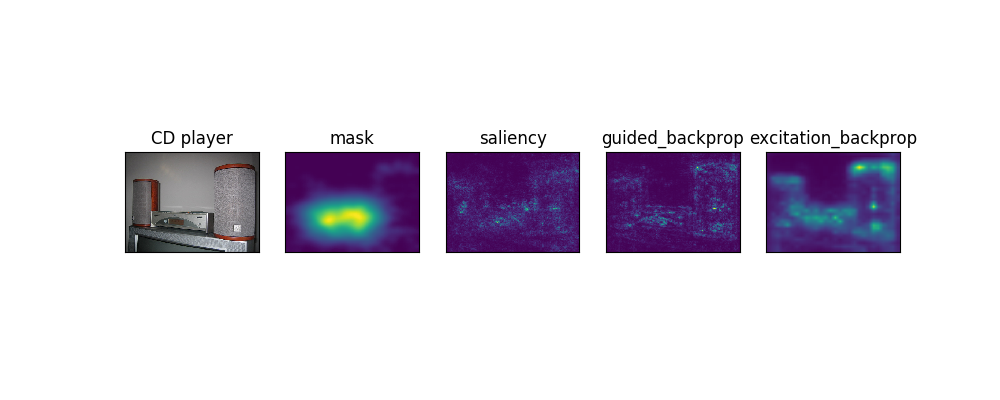

<IPython.core.display.Javascript object>


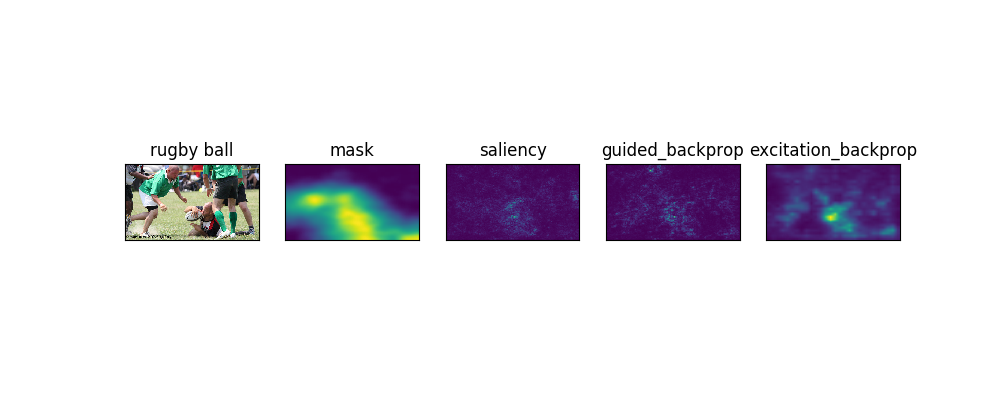

<IPython.core.display.Javascript object>


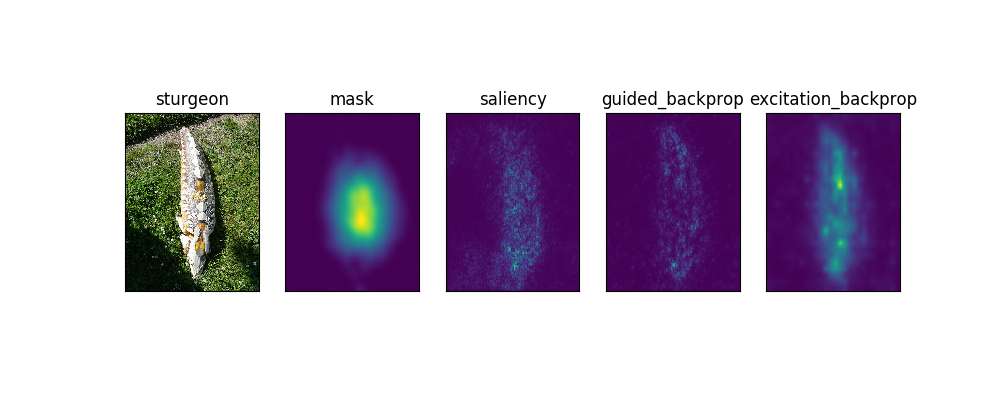

In [47]:
interested_idx = [10, # Pomeranian
                  11, # water ouzel
                  12, # chocolate sauce
                  17, # street sign
                  25, # rugby ball
                  30, # pickup truck
                  40, # bonnet
                  44, # Chihuahua
                  48, # pill bottle
                  79, # loud speaker
                  86, # rugby ball
                  88, # sturgeon
                 ]
for i in interested_idx:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    visualize_heatmaps(net, img_path, mask_path, ann_path, label, show_bbs = False, mask_alpha = mask_alpha, mask_flip = True, thres_first = True, gpu = None,
                           synsets = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synsets.txt', str, delimiter='\t'),
                           indexing = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/ascii_order_to_synset_order.txt'))

<IPython.core.display.Javascript object>


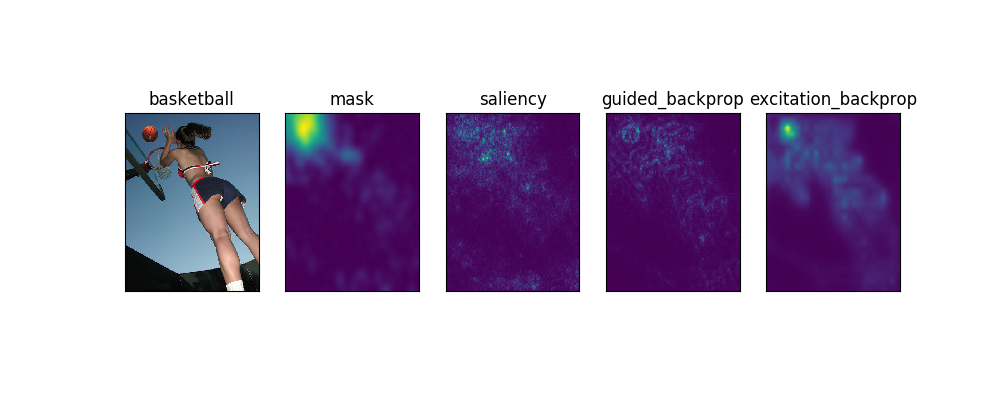

<IPython.core.display.Javascript object>


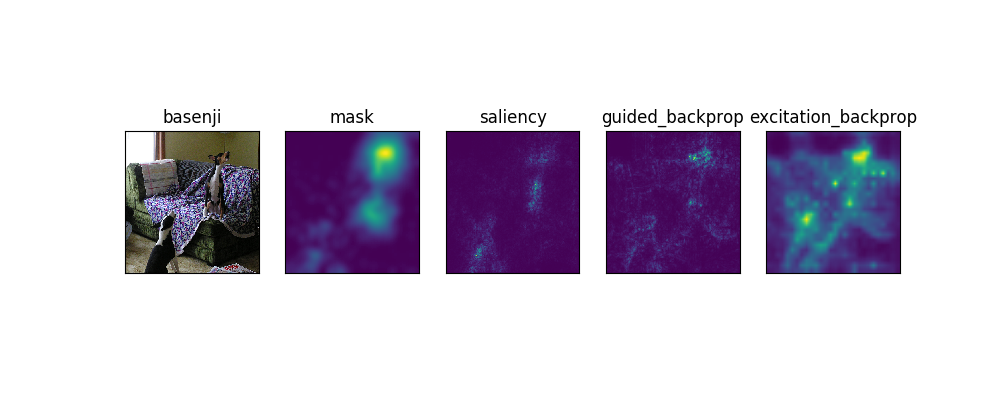

<IPython.core.display.Javascript object>


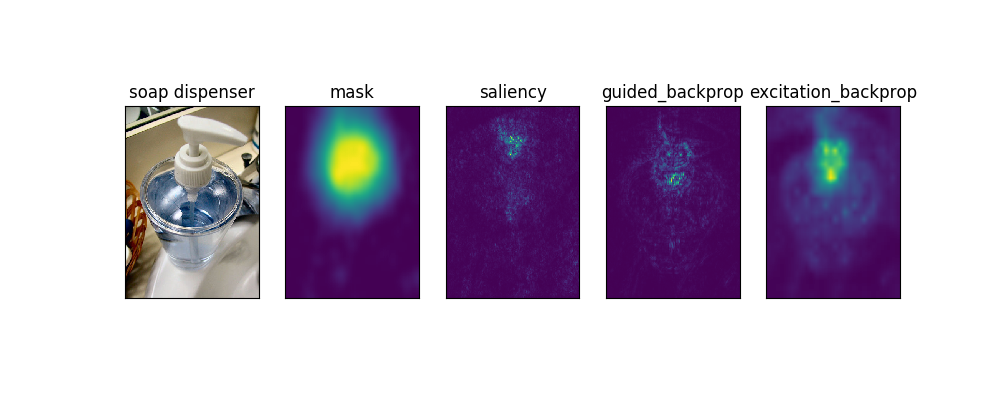

<IPython.core.display.Javascript object>


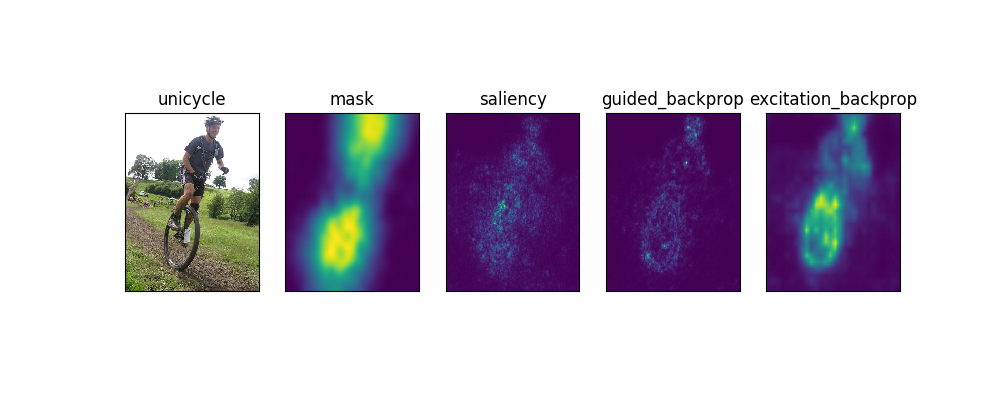

<IPython.core.display.Javascript object>


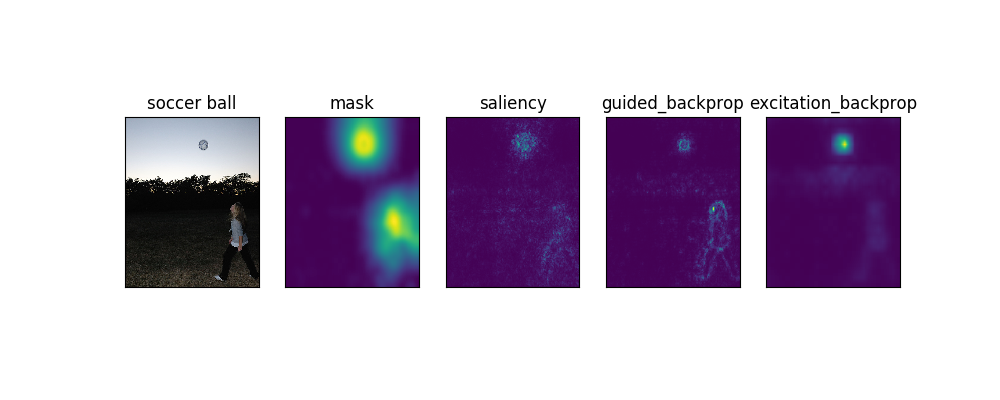

<IPython.core.display.Javascript object>


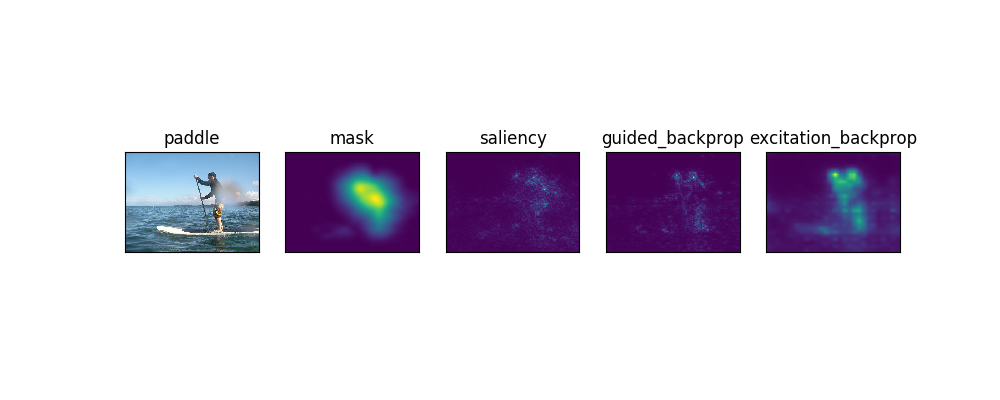

<IPython.core.display.Javascript object>


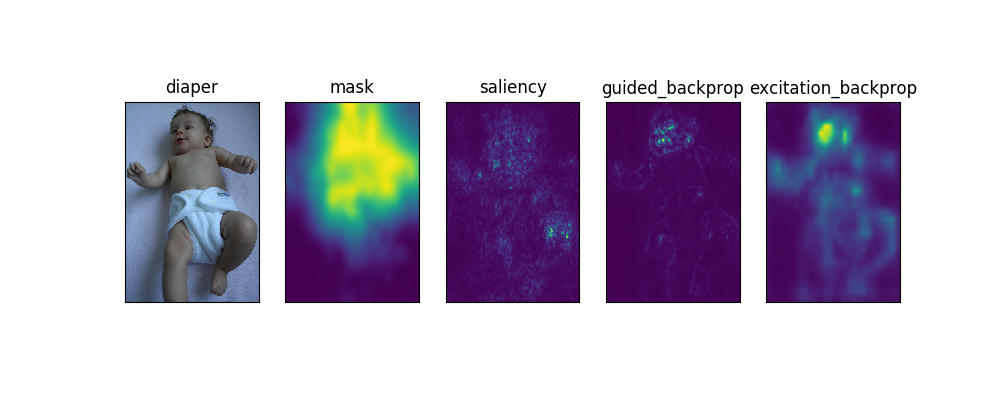

<IPython.core.display.Javascript object>


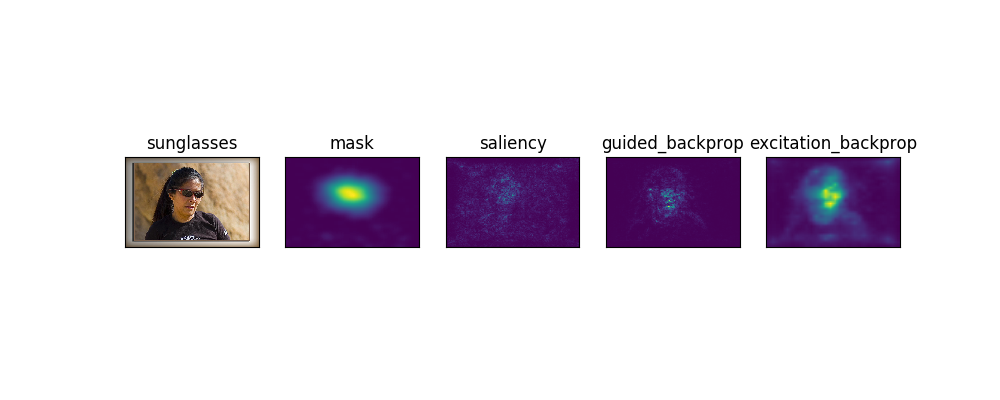

<IPython.core.display.Javascript object>


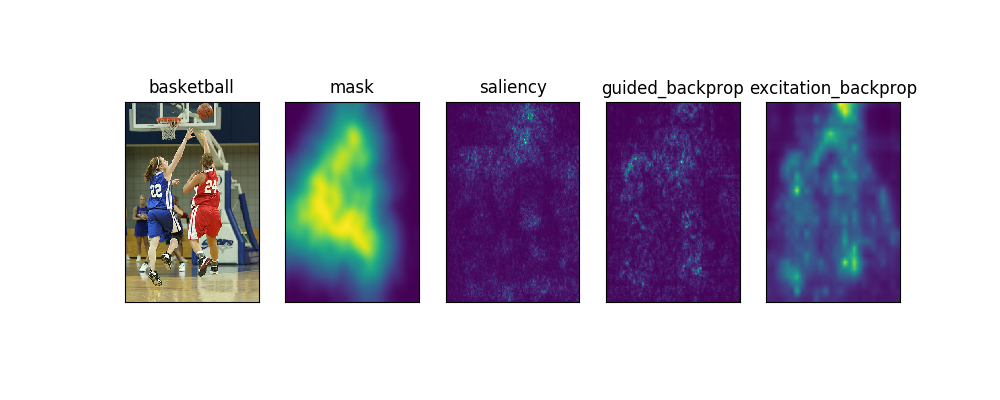

<IPython.core.display.Javascript object>


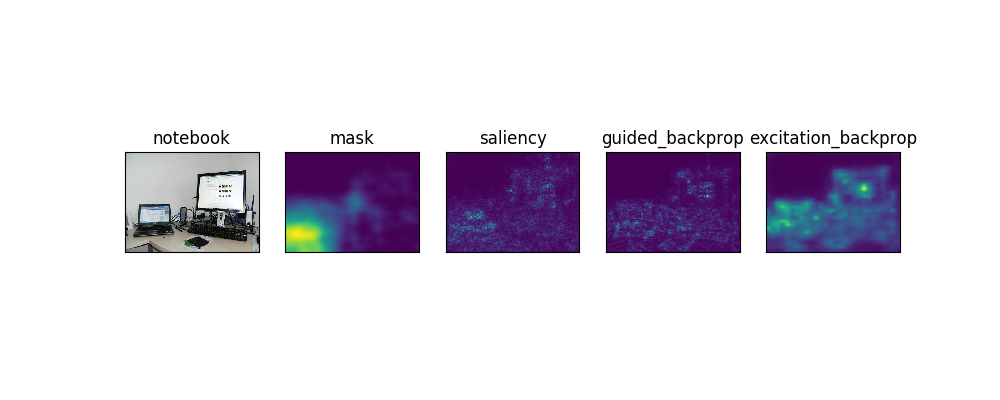

<IPython.core.display.Javascript object>


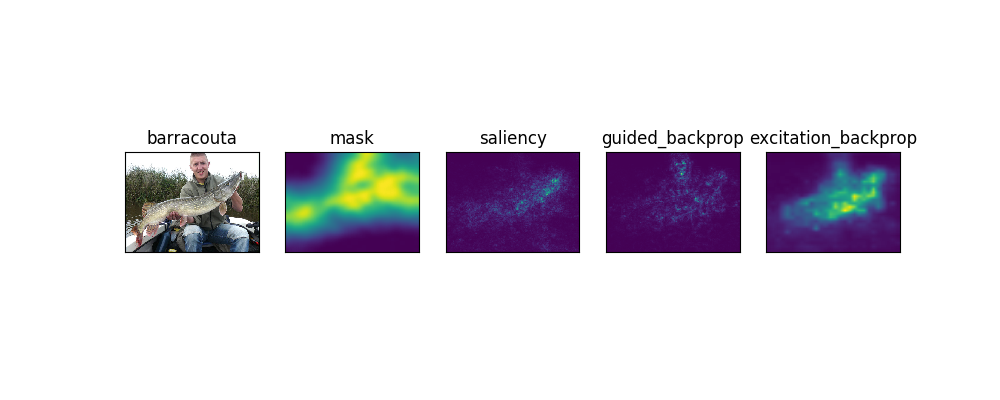

In [53]:
interested_idx = [150, 170, 199, 206, 263, 301, 311, 322, 327, 363, 371]
for i in interested_idx:
    img_path = paths[i]
    mask_path = mask_paths[i]
    ann_path = ann_paths[i]
    label = labels[i]
    visualize_heatmaps(net, img_path, mask_path, ann_path, label, show_bbs = False, mask_alpha = mask_alpha, mask_flip = True, thres_first = True, gpu = None,
                           synsets = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synsets.txt', str, delimiter='\t'),
                           indexing = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/ascii_order_to_synset_order.txt'))

In [ ]:
%matplotlib inline

ind = 12 #12: chocolate sauce example #18: snorkeling example
img_path = paths[ind]
label = labels[ind]
mask_path = mask_paths[ind]
ann_path = ann_paths[ind]

net_transformer = get_ILSVRC_net_transformer(net)

img = net_transformer.preprocess('data', caffe.io.load_image(img_path))
null_img = net_transformer.preprocess('data', get_blurred_img(img_path))
net.blobs['data'].data[...] = img
net.forward()
scores = np.squeeze(net.blobs['prob'].data)
sorted_idx = np.argsort(scores)

for i in range(5):
    print (i+1), labels_desc[sorted_idx[-(i+1)]], scores[sorted_idx[-(i+1)]]

plt.imshow(net_transformer.deprocess('data', img))
plt.show()

objs = load_objs(ann_path)
[x0, y0, x1, y1] = objs[synsets[label]][0]
print x0, y0, x1, y1

gt_mask = np.ones(caffe.io.load_image(img_path).shape[:2])
gt_mask[y0:y1, x0:x1] = 0
gt_mask = scipy.misc.imresize(gt_mask, (net.blobs['data'].data.shape[2], 
                                        net.blobs['data'].data.shape[3]), 'nearest')/float(255)
gt_masked_img = img * gt_mask + null_img * (1 - gt_mask)
net.blobs['data'].data[...] = gt_masked_img
net.forward()
scores = np.squeeze(net.blobs['prob'].data)
sorted_idx = np.argsort(scores)

for i in range(5):
    print (i+1), labels_desc[sorted_idx[-(i+1)]], scores[sorted_idx[-(i+1)]]

plt.imshow(net_transformer.deprocess('data', gt_masked_img))
plt.show()

gt_mask = np.ones(caffe.io.load_image(img_path).shape[:2])
#gt_mask[125:, 150:] = 0 # snorkel
gt_mask[25:180, 205:375] = 0
gt_mask = scipy.misc.imresize(gt_mask, (net.blobs['data'].data.shape[2], 
                                        net.blobs['data'].data.shape[3]), 'nearest')/float(255)
gt_masked_img = img * gt_mask + null_img * (1 - gt_mask)
net.blobs['data'].data[...] = gt_masked_img
net.forward()
scores = np.squeeze(net.blobs['prob'].data)
sorted_idx = np.argsort(scores)

for i in range(5):
    print (i+1), labels_desc[sorted_idx[-(i+1)]], scores[sorted_idx[-(i+1)]]

plt.imshow(net_transformer.deprocess('data', gt_masked_img))
plt.show()

gt_mask = np.ones(caffe.io.load_image(img_path).shape[:2])
gt_mask[190:320, 140:430] = 0
gt_mask = scipy.misc.imresize(gt_mask, (net.blobs['data'].data.shape[2], 
                                        net.blobs['data'].data.shape[3]), 'nearest')/float(255)
gt_masked_img = img * gt_mask + null_img * (1 - gt_mask)
net.blobs['data'].data[...] = gt_masked_img
net.forward()
scores = np.squeeze(net.blobs['prob'].data)
sorted_idx = np.argsort(scores)

for i in range(5):
    print (i+1), labels_desc[sorted_idx[-(i+1)]], scores[sorted_idx[-(i+1)]]

plt.imshow(net_transformer.deprocess('data', gt_masked_img))
plt.show()


mask = np.load(mask_path)
masked_img = img * mask + null_img * (1-mask)
net.blobs['data'].data[...] = masked_img
net.forward()
scores = np.squeeze(net.blobs['prob'].data)
sorted_idx = np.argsort(scores)

for i in range(5):
    print (i+1), labels_desc[sorted_idx[-(i+1)]], scores[sorted_idx[-(i+1)]]

plt.imshow(net_transformer.deprocess('data', masked_img))
plt.show()

In [ ]:
plt.imshow(caffe.io.load_image(img_path))
plt.show()
print caffe.io.load_image(img_path).shape